<a href="https://colab.research.google.com/github/dwm-multimidia/dwm-multimidia.github.io/blob/master/lab4/jupyter/Lab4_ImageDWT_a1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ESTI019 - QS2021 - CSM - Lab4

# Lab4 - Codificação de Imagem com DWT 

A. Objetivos:


1.   Efetuar a Codificação de Imagem e a Decodificação por DWT e IDWT
2.   Testar funções de Codificação Multinível
3.   Verificar a taxa de compressão só com a Componente de Aproximação

In [21]:
import numpy as np
import cv2 as cv
import pywt
import pywt.data
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import inspect
import pandas as pd

B. Monte o seu google drive e verifique os seus arquivos:

In [3]:
from pathlib import Path
import shutil

dirGit = Path('/content/dwm-multimidia.github.io/')
if dirGit.exists():
  shutil.rmtree(dirGit)

!git clone https://github.com/dwm-multimidia/dwm-multimidia.github.io.git

dirLab4 = dirGit.joinpath('lab4/imagens/')
print('\nAgora temos acesso aos arquivos:\n\t', '\n\t '.join([str(arquivo) for arquivo in dirLab4.iterdir()]))

dirLab4 = dirGit.joinpath('lab4/jupyter/')
print('\t', '\n\t '.join([str(arquivo) for arquivo in dirLab4.iterdir()]))

Cloning into 'dwm-multimidia.github.io'...
remote: Enumerating objects: 376, done.
remote: Counting objects: 100% (376/376), done.
remote: Compressing objects: 100% (275/275), done.
remote: Total 376 (delta 172), reused 241 (delta 77), pack-reused 0
Receiving objects: 100% (376/376), 106.68 MiB | 21.25 MiB/s, done.
Resolving deltas: 100% (172/172), done.

Agora temos acesso aos arquivos:
	 /content/dwm-multimidia.github.io/lab4/imagens/william.png
	 /content/dwm-multimidia.github.io/lab4/imagens/dimitri.png
	 /content/dwm-multimidia.github.io/lab4/imagens/dimitri_william_matheus.png
	 /content/dwm-multimidia.github.io/lab4/imagens/matheus.png
	 /content/dwm-multimidia.github.io/lab4/jupyter/peppers.png
	 /content/dwm-multimidia.github.io/lab4/jupyter/Lab4_ImageDWT_x.ipynb


C. Codificação de Luminância (P&B) com DWT para a Pimentas

Text(0.5, 1.0, 'CD - Bordas Diagonais')

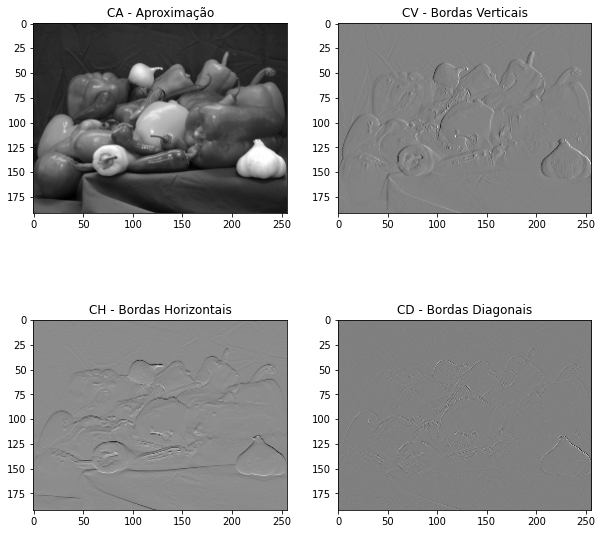

In [ ]:
img = mpimg.imread(str(dirLab4 / 'peppers.png'))

img_gray = cv.cvtColor(img, cv.COLOR_RGB2GRAY)


coefs2 = pywt.dwt2(img_gray,'haar', mode='periodization')  #1 nível de DWT
(cA, (cH, cV, cD)) = coefs2 #Separando os coeficientes
imgr = pywt.idwt2(coefs2, 'haar', mode = 'periodization')  #1 nível de IDWT

plt.figure(figsize=(10,10))
plt.subplot(2,2,1)
plt.imshow(cA,'gray'); plt.title("CA - Aproximação")
plt.subplot(2,2,2)
plt.imshow(cV,'gray'); plt.title("CV - Bordas Verticais")
plt.subplot(2,2,3)
plt.imshow(cH,'gray'); plt.title("CH - Bordas Horizontais")
plt.subplot(2,2,4)
plt.imshow(cD,'gray'); plt.title("CD - Bordas Diagonais")


C.1 Cálculo do Erro Quadrático Médio (MSE) e da Relação Sinal Ruído de Pico (PSNR)

a) A MSE é obtida calculando somando-se o erro quadrático de reconstrução pixel a pixel entre a Imagem Original (O) da Reconstruída (R) e normalizando pela dimensão (LxA) da imagem:

$ MSE = \frac{1}{LA}{\sum_{i=0}^L}{\sum_{j=0}^A [O(i,j) - R(i,j)]^2}$

b) A SNR de pico (PSNR) é definida para cada plano componente da imagem como:

$ PSNR = 10.log_{10} \left( \frac{{MAX_I}^2}{MSE} \right) $

sendo $MAX_I$ o valor máximo do pixel, que para 8 bits equivale a 255, logo:

$ PSNR = 20.log_{10}(255) - 10.log_{10} (MSE) $

OBS.: Para uma imagem RGB, $ MSE = MSE_R + MSE_G + MSE_B $, sendo similar definiação para YCrCb e HSV


MSE_Y = 1.62e-13
PSNR_Luma = 176.03 dB


Text(0.5, 1.0, 'Imagem Reconstruída de Luminância (Y) com PSNR = 176 dB')

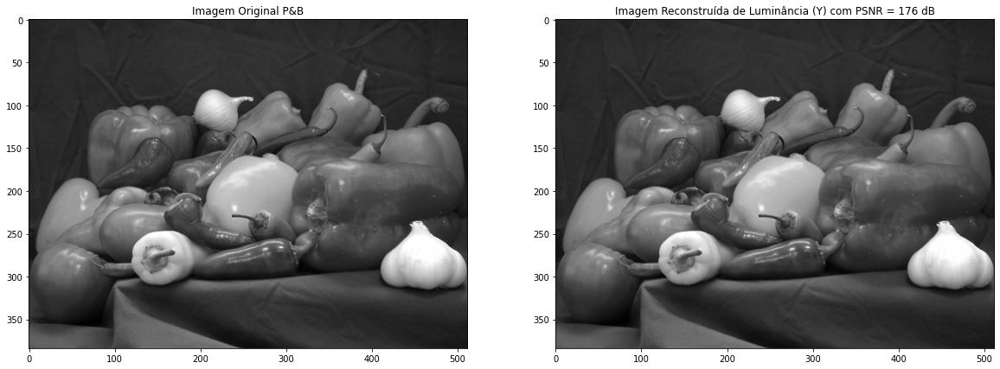

In [ ]:
# Calculo da MSE P&B
A, L, Camadas = img.shape
dif = img_gray - imgr
MSE_gray = np.sum(np.matmul(dif,np.transpose(dif)))/(A*L)
print("MSE_Y = {:.2e}".format(MSE_gray))
PSNR_Y = 20*np.log10(255) - 10*np.log10(MSE_gray)
print("PSNR_Luma = {:.2f} dB".format(PSNR_Y))
plt.figure(figsize=(20,10))
infograf = "Imagem Reconstruída de Luminância (Y) com PSNR = " + str(np.uint8(PSNR_Y)) + ' dB'
plt.subplot(1,2,1); plt.imshow(img_gray,'gray'); plt.title("Imagem Original P&B")
plt.subplot(1,2,2); plt.imshow(imgr,'gray'); plt.title(infograf)

D. Teste das Funções de Multiresolução wavedec2() e waverec2()

Text(0.5, 1.0, 'Imagem Reconstruída')

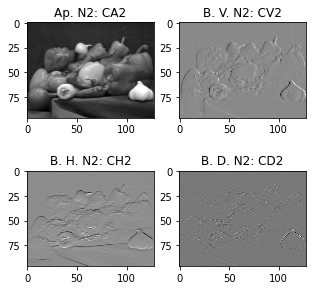

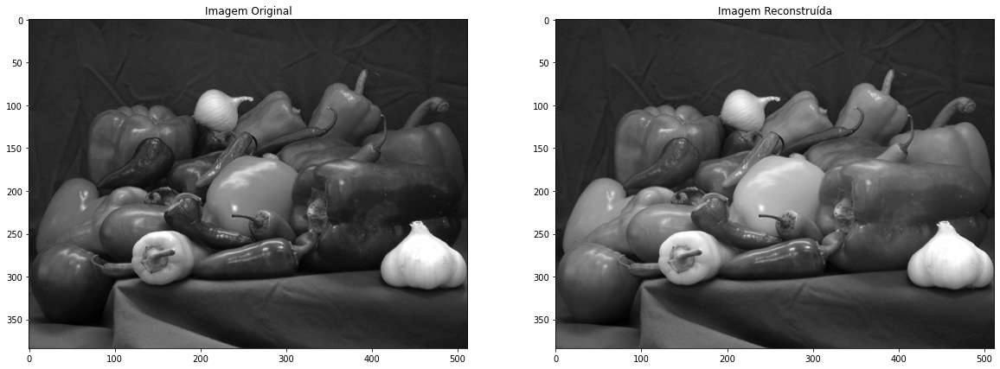

In [ ]:
C = pywt.wavedec2(img_gray,'haar', mode = 'symmetric', level=2) # Dois níveis de decomposição DWT
imgr2 = pywt.waverec2(C, 'haar', mode = 'symmetric') # Dois níveis de IDWT

# Para extrair os coeficientes de cada nível
cA2 = C[0]  # Coeficientes de Aproximação nível 2
(cH1, cV1, cD1) = C[-1] # Coeficientes de Detalhes nível 1
(cH2, cV2, cD2) = C[-2] # Coeficientes de Detalhes nível 2

# Imagem Original
img_gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

# Plot dos coeficientes do nível 2
plt.figure(figsize=(5,5))
plt.subplot(2,2,1)
plt.imshow(cA2, 'gray'); plt.title('Ap. N2: CA2')
plt.subplot(2,2,2)
plt.imshow(cV2, 'gray'); plt.title('B. V. N2: CV2')
plt.subplot(2,2,3)
plt.imshow(cH2, 'gray'); plt.title('B. H. N2: CH2')
plt.subplot(2,2,4)
plt.imshow(cD2, 'gray'); plt.title('B. D. N2: CD2')

# Plot Original e Reconstrução
plt.figure(figsize=(20,10))
plt.subplot(1,2,1); plt.imshow(img_gray,'gray'); plt.title('Imagem Original')
plt.subplot(1,2,2); plt.imshow(imgr2,'gray'); plt.title('Imagem Reconstruída')


E. Efetuar uma "Montagem" com wavedec2() e wavedecn() 

1º Nível

In [ ]:
CV1 = cV1.copy()
CH1 = cH1.copy()
CD1 = cD1.copy()

2º Nível

In [ ]:
CA2 = cA2.copy()
CH2 = cH2.copy()
CV2 = cV2.copy()
CD2 = cD2.copy()
# Matriz Final Completa
CA1 = np.bmat([[CA2,CV2],[CH2,CD2]])
CC = np.bmat([[CA1,CV1],[CH1,CD1]])

Text(0.5, 1.0, 'Codificação de Imagem em multinível com função wavedec2()')

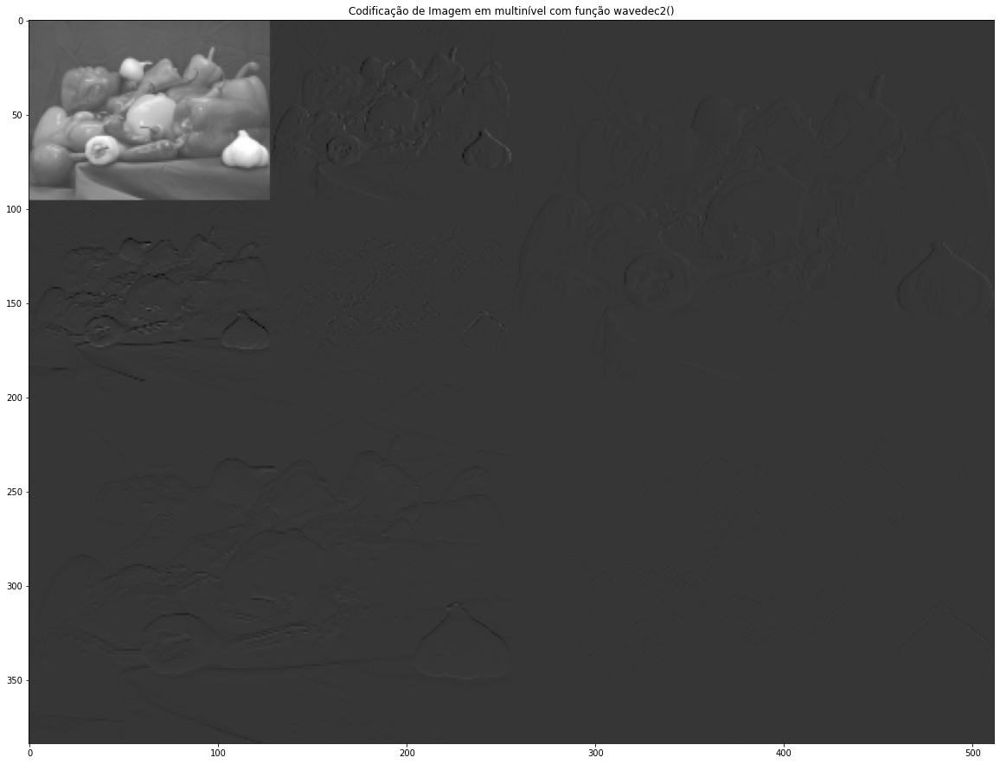

In [ ]:
plt.figure(figsize=(20,20))
plt.imshow(CC,'gray')
plt.title('Codificação de Imagem em multinível com função wavedec2()')

F. Reconstrução de Imagem Colorida

Text(0.5, 1.0, 'Imagem Reconstruída Red')

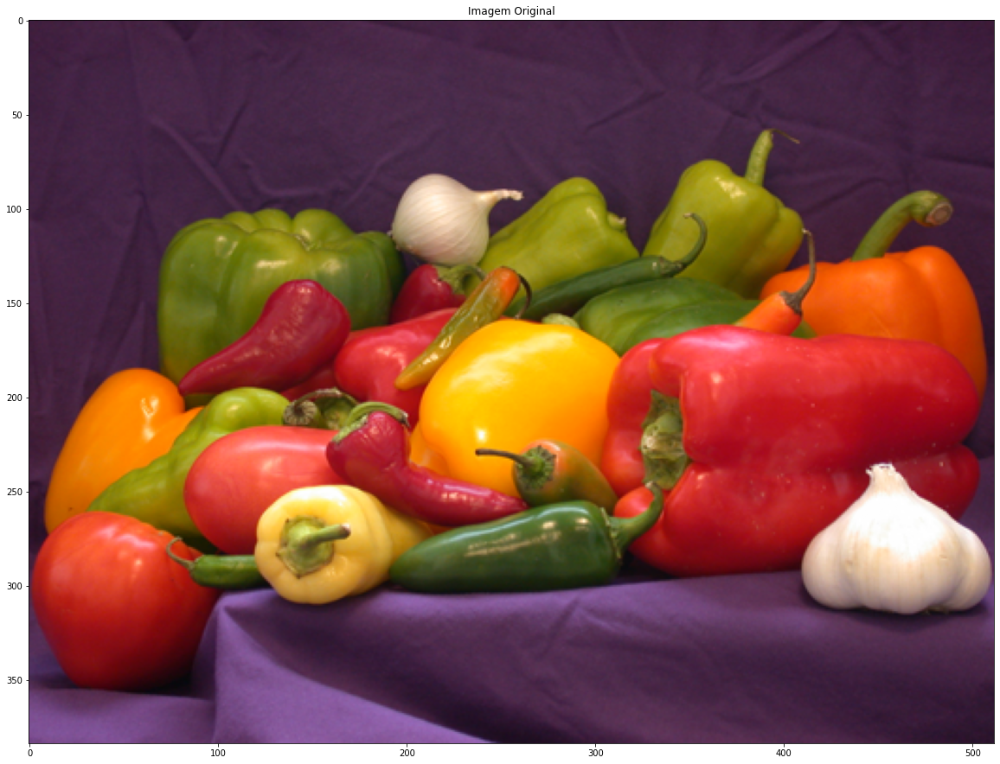

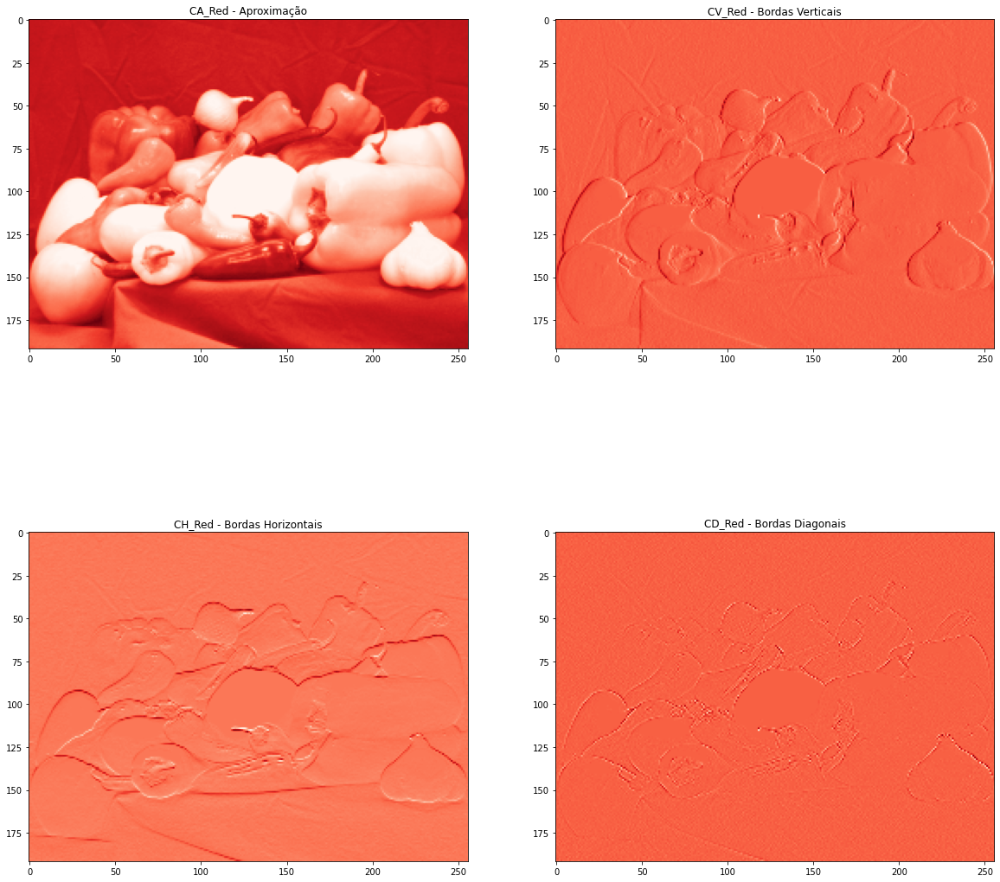

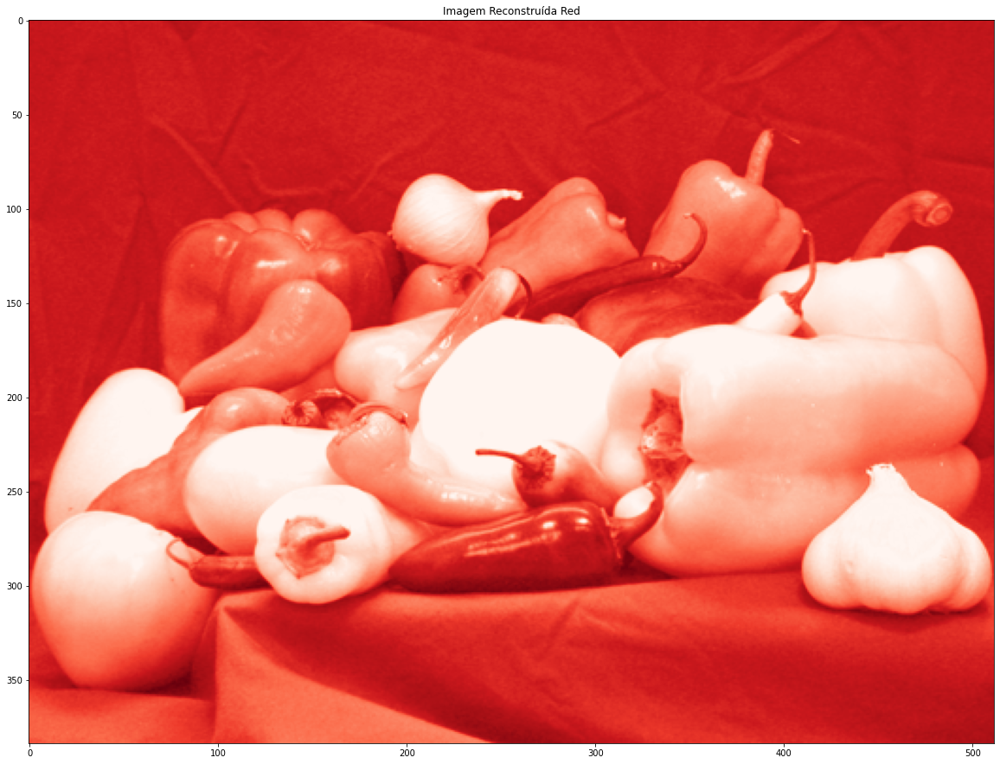

In [ ]:
# Imagem Original

plt.figure(figsize=(20,20))
plt.imshow(img); plt.title("Imagem Original")

# Codificação por planos de cores
# Plano Vermelho
coefs_R = pywt.dwt2(img[:,:,0],'haar', mode='periodization')  #1 nível de DWT R
(cA_R, (cH_R, cV_R, cD_R)) = coefs_R #Separando os coeficientes
cr_R = pywt.idwt2(coefs_R, 'haar', mode = 'periodization')  #1 nível de IDWT R

plt.figure(figsize=(20,20))
plt.subplot(2,2,1)
plt.imshow(cA_R,'Reds_r'); plt.title("CA_Red - Aproximação")
plt.subplot(2,2,2)
plt.imshow(cV_R,'Reds_r'); plt.title("CV_Red - Bordas Verticais")
plt.subplot(2,2,3)
plt.imshow(cH_R,'Reds_r'); plt.title("CH_Red - Bordas Horizontais")
plt.subplot(2,2,4)
plt.imshow(cD_R,'Reds_r'); plt.title("CD_Red - Bordas Diagonais")

plt.figure(figsize=(20,20))
plt.imshow(cr_R, 'Reds_r'); plt.title("Imagem Reconstruída Red")


Text(0.5, 1.0, 'Imagem Reconstruída Green')

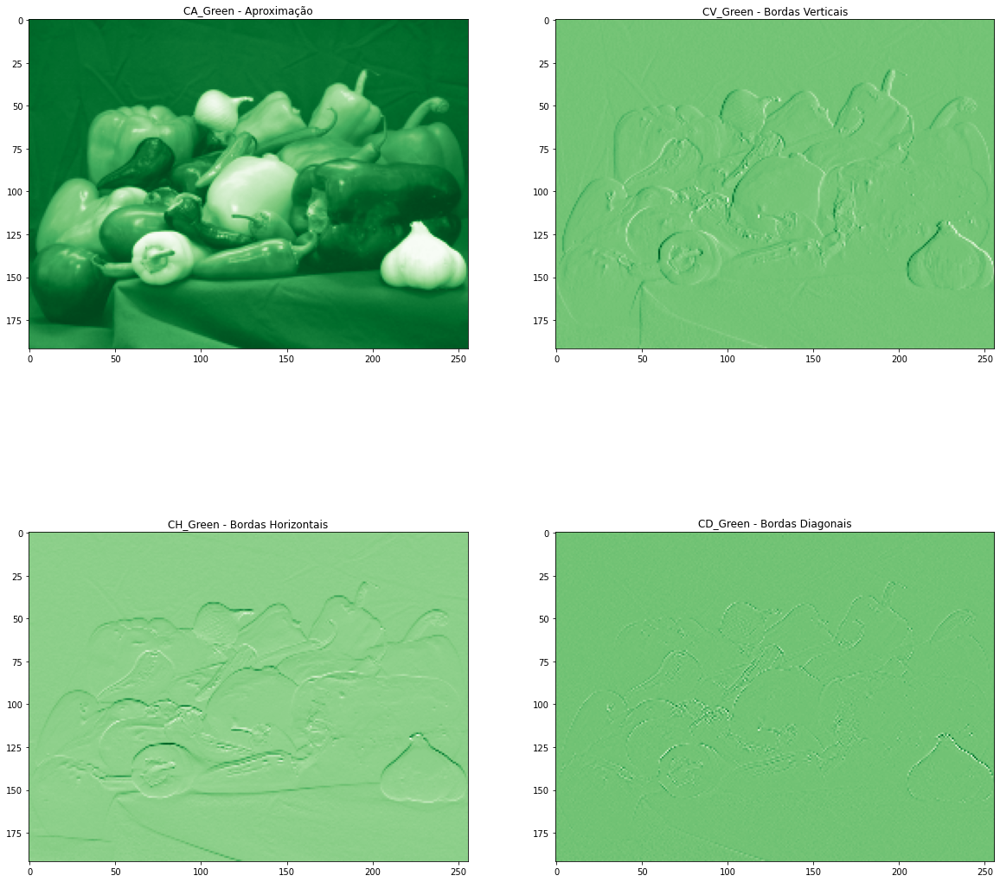

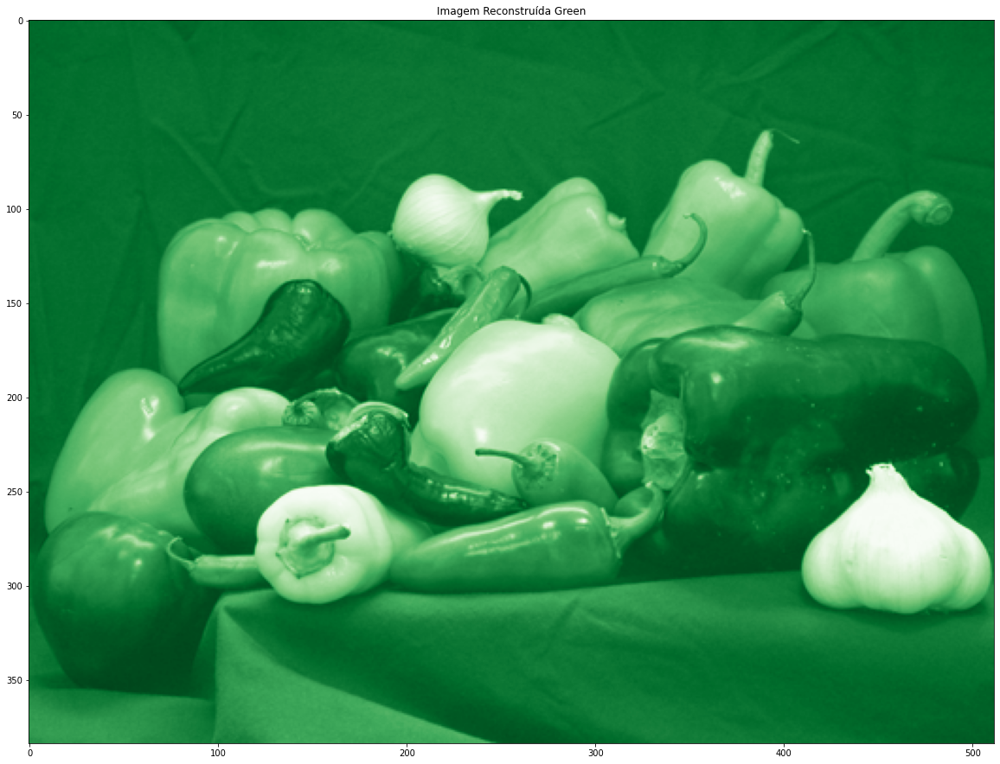

In [ ]:
# Plano Verde
coefs_G = pywt.dwt2(img[:,:,1],'haar', mode='periodization')  #1 nível de DWT G
(cA_G, (cH_G, cV_G, cD_G)) = coefs_G #Separando os coeficientes
cr_G = pywt.idwt2(coefs_G, 'haar', mode = 'periodization')  #1 nível de IDWT G

plt.figure(figsize=(20,20))
plt.subplot(2,2,1)
plt.imshow(cA_G,'Greens_r'); plt.title("CA_Green - Aproximação")
plt.subplot(2,2,2)
plt.imshow(cV_G,'Greens_r'); plt.title("CV_Green - Bordas Verticais")
plt.subplot(2,2,3)
plt.imshow(cH_G,'Greens_r'); plt.title("CH_Green - Bordas Horizontais")
plt.subplot(2,2,4)
plt.imshow(cD_G,'Greens_r'); plt.title("CD_Green - Bordas Diagonais")

plt.figure(figsize=(20,20))
plt.imshow(cr_G, 'Greens_r'); plt.title("Imagem Reconstruída Green")

Text(0.5, 1.0, 'Imagem Reconstruída Blue')

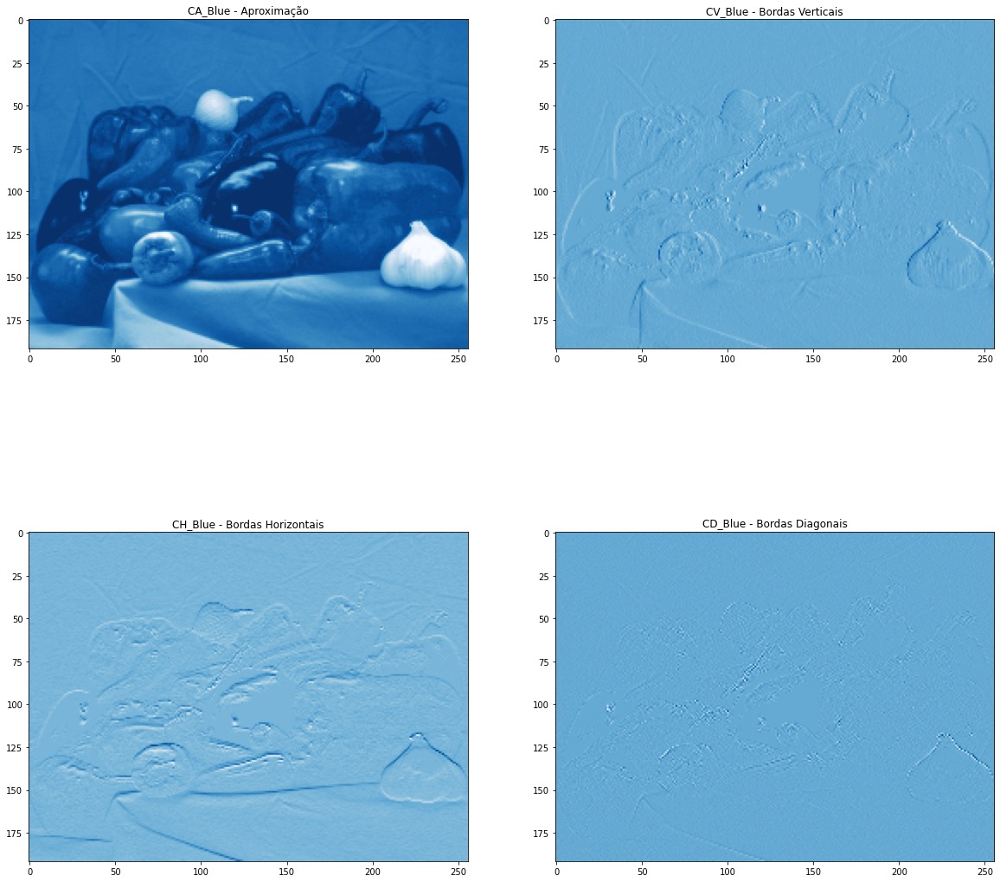

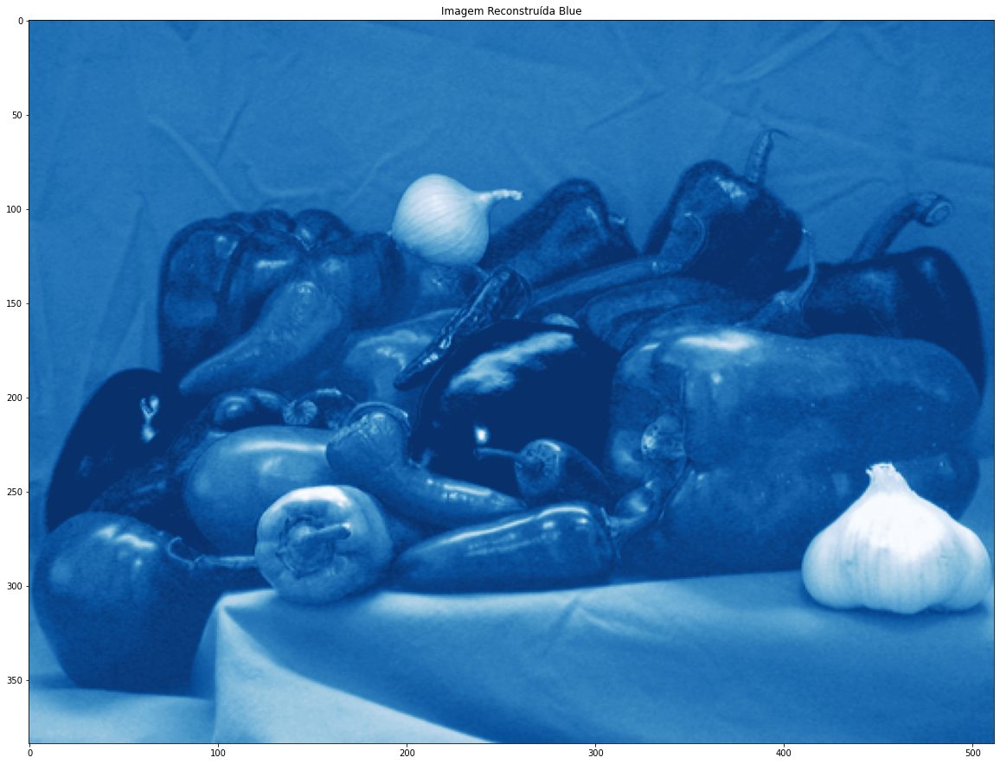

In [ ]:
# Plano Azul
coefs_B = pywt.dwt2(img[:,:,2],'haar', mode='periodization')  #1 nível de DWT B
(cA_B, (cH_B, cV_B, cD_B)) = coefs_B #Separando os coeficientes
cr_B = pywt.idwt2(coefs_B, 'haar', mode = 'periodization')  #1 nível de IDWT B

plt.figure(figsize=(20,20))
plt.subplot(2,2,1)
plt.imshow(cA_B,'Blues_r'); plt.title("CA_Blue - Aproximação")
plt.subplot(2,2,2)
plt.imshow(cV_B,'Blues_r'); plt.title("CV_Blue - Bordas Verticais")
plt.subplot(2,2,3)
plt.imshow(cH_B,'Blues_r'); plt.title("CH_Blue - Bordas Horizontais")
plt.subplot(2,2,4)
plt.imshow(cD_B,'Blues_r'); plt.title("CD_Blue - Bordas Diagonais")

plt.figure(figsize=(20,20))
plt.imshow(cr_B, 'Blues_r'); plt.title("Imagem Reconstruída Blue")

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'Imagem Reconstruída DWT/IDWT Nível 1')

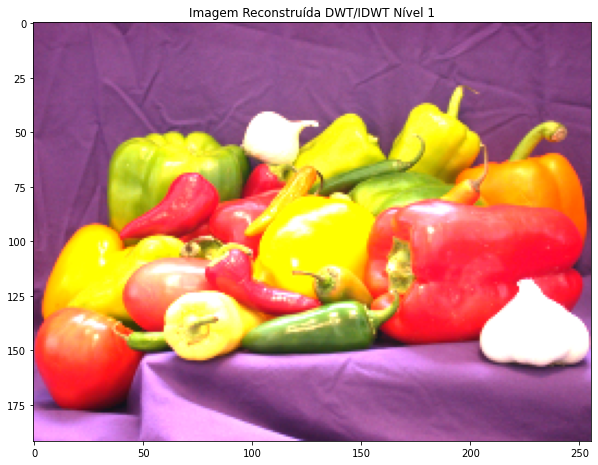

In [ ]:
# Reconstrução Nível 1 Colorida 
A1, L1 = cA_R.shape
imgrec1 = np.zeros((A1,L1,3))
imgrec1[:,:,0] = cA_R.copy()
imgrec1[:,:,1] = cA_G.copy()
imgrec1[:,:,2] = cA_B.copy()
plt.figure(figsize=(10,10))
plt.imshow(imgrec1); plt.title("Imagem Reconstruída DWT/IDWT Nível 1")


G. Salvando as Aproximações e depois fazendo download dos arquivos, calcular a taxa de compressão com o original

In [ ]:
# obtenha aproximação de NÍVEL 1 e converte para inteiro
C1 = pywt.wavedec2(img_gray,'haar', mode = 'symmetric', level=1) # Um nível de decomposição DWT
CA1_ = 255 * C1[0] / np.abs(C1[0]).max()
CA1_ = CA1_.astype(int)

# aproximação de NÍVEL 2 - ja´obtido no item (D) e converte para inteiro
CA2_ = 255 * cA2 / np.abs(cA2).max()
CA2_ = CA2_.astype(int)

# Salva no drive
cv.imwrite('drive/My Drive/Colab Notebooks/peppers_DWT_N1_Y.bmp', CA1_) # Aproximação Nível 1 só Y
cv.imwrite('drive/My Drive/Colab Notebooks/peppers_DWT_N2_Y.bmp', CA2_) # Aproximação Nível 2 só Y


False

H. Gravando o Arquivo Codificado DWT/IDWT nível 1 Colorido, calcular a taxa de compressão com o original

In [ ]:
# Aproximação Nível 1 Colorida 
# converte RGB para BGR e converte para inteiro
imgrec1_ = np.zeros((A1,L1,3))
imgrec1_[:,:,0] = imgrec1[:,:,2] 
imgrec1_[:,:,1] = imgrec1[:,:,1] 
imgrec1_[:,:,2] = imgrec1[:,:,0] 
imgrec1_ = ( 255 * imgrec1_ / np.abs(imgrec1_).max() ).astype(int)

# Salva no drive
cv.imwrite('drive/My Drive/Colab Notebooks/peppers_DWT_N1_colorida.bmp', imgrec1_) # Gravando Aproximação Nível 1 Colorida

False

I. Reconstrução da Imagem colorida e Cálculo da MSE de cada plano de cor e da PSNR total

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


MSE_Red= 4.28e-13  MSE_Green= 1.12e-13  MSE_Blue= 8.70e-14
PSNR total = 170.16 dB


Text(0.5, 1.0, 'Imagem Reconstruída com PSNR total = 170 dB')

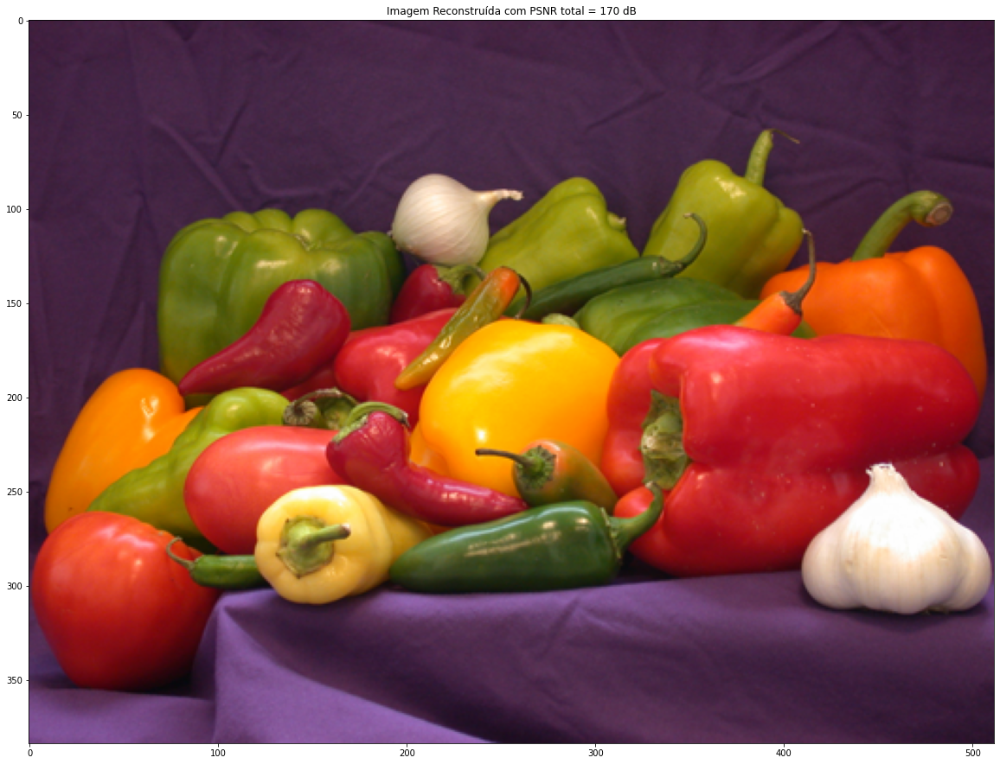

In [ ]:
# Reconstrução Colorida Original
A,L = imgr2.shape
imgrec = np.zeros((A,L,3))
imgrec[:,:,0] = cr_R.copy()
imgrec[:,:,1] = cr_G.copy()
imgrec[:,:,2] = cr_B.copy()

# Calculo do MSE colorida
dif2 = img - imgrec
MSE_R = np.sum(np.matmul(dif2[:,:,0],np.transpose(dif2[:,:,0])))/(A*L) # Erro Quadrático Médio plano R
MSE_G = np.sum(np.matmul(dif2[:,:,1],np.transpose(dif2[:,:,1])))/(A*L) # Erro Quadrático Médio plano G
MSE_B = np.sum(np.matmul(dif2[:,:,2],np.transpose(dif2[:,:,2])))/(A*L) # Erro Quadrático Médio plano B
print("MSE_Red= {:.2e}".format(MSE_R), " MSE_Green= {:.2e}".format(MSE_G), " MSE_Blue= {:.2e}".format(MSE_B))

# Cálculo da SNR de pico colorida (PSNR), 3 camadas R, G e B
PSNR = 20*np.log10(255) - 10*np.log10(MSE_R + MSE_G + MSE_B)
print("PSNR total = {:.2f} dB".format(PSNR))

plt.figure(figsize=(20,20))
infograf2 = "Imagem Reconstruída com PSNR total = " + str(np.uint8(PSNR)) + ' dB'
plt.imshow(imgrec); plt.title(infograf2)

# I. Cada um deve repetir todos os passos para a sua foto individual

# J. Relatório (página)


1.   Acrescentar também a foto-montagem do grupo todo, mas codificar esta foto-montagem em um nível com DWT também as componentes Cr e Cb (efetuamos aqui apenas para a componente Y)
2.   Fazer uma tabela com as taxas de compressão obtidas e a PSNR de cada uma das fotos utilizadas



### Funções para rodar todo o código novamente para as fotos individuais

In [31]:
def main(caminhoImg):
  print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
  
  def abrir_imagem(caminhoImg):
    print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
    return mpimg.imread(str(caminhoImg))
  img = abrir_imagem(caminhoImg)
    
  def converter_cinza(img):
    print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
    return cv.cvtColor(img, cv.COLOR_RGB2GRAY)
  img_gray = converter_cinza(img)

  def dwt_idwt(img_gray):
    print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
    coefs2 = pywt.dwt2(img_gray,'haar', mode='periodization')
    (cA, (cH, cV, cD)) = coefs2
    imgr = pywt.idwt2(coefs2, 'haar', mode = 'periodization')
    return coefs2, imgr, cA, cH, cV, cD
  coefs2, imgr, cA, cH, cV, cD = dwt_idwt(img_gray)

  def plotar_coefs(cA, cV, cH, cD):
    print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
    plt.figure(figsize=(10,10))
    plt.subplot(2,2,1)
    plt.imshow(cA,'gray')
    plt.title("CA - Aproximação")
    plt.subplot(2,2,2)
    plt.imshow(cV,'gray')
    plt.title("CV - Bordas Verticais")
    plt.subplot(2,2,3)
    plt.imshow(cH,'gray')
    plt.title("CH - Bordas Horizontais")
    plt.subplot(2,2,4)
    plt.imshow(cD,'gray')
    plt.title("CD - Bordas Diagonais")
    plt.show()
    return None
  _ = plotar_coefs(cA, cV, cH, cD)

  def calcular_mse_peb(img, img_gray, imgr, verbose=True):
    print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
    A = min([img.shape[0], img_gray.shape[0], imgr.shape[0]])
    L = min([img.shape[1], img_gray.shape[1], imgr.shape[1]])
    img      = img[:A, :L, :img.shape[2]]
    img_gray = img_gray[:A, :L]
    imgr     = imgr[:A, :L]
    dif      = img_gray - imgr
    MSE_gray = np.sum(np.matmul(dif,np.transpose(dif)))/(A*L)
    PSNR_Y   = 20*np.log10(255) - 10*np.log10(MSE_gray)
    if verbose:
      print("MSE_Y = {:.2e}".format(MSE_gray))
      print("PSNR_Luma = {:.2f} dB".format(PSNR_Y))
    return MSE_gray, PSNR_Y, img, img_gray, imgr
  MSE_gray, PSNR_Y, img, img_gray, imgr = calcular_mse_peb(img, img_gray, imgr)

  def plotar_reconstrucao():
    print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
    plt.figure(figsize=(20,10))
    infograf = "Imagem Reconstruída de Luminância (Y) com PSNR = " + str(np.uint8(PSNR_Y)) + ' dB'
    plt.subplot(1,2,1)
    plt.imshow(img_gray,'gray')
    plt.title("Imagem Original P&B")
    plt.subplot(1,2,2)
    plt.imshow(imgr,'gray')
    plt.title(infograf)
    plt.show()
    return None
  _ = plotar_reconstrucao()

  def dwt_idwt_2(img_gray):
    print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
    C = pywt.wavedec2(img_gray,'haar', mode = 'symmetric', level=2)
    imgr2 = pywt.waverec2(C, 'haar', mode = 'symmetric')
    cA2 = C[0]
    (cH1, cV1, cD1) = C[-1]
    (cH2, cV2, cD2) = C[-2]
    img_gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    return C, img_gray, imgr2, cA2, cH1, cV1, cD1, cH2, cV2, cD2
  C, img_gray, imgr2, cA2, cH1, cV1, cD1, cH2, cV2, cD2 = dwt_idwt_2(img_gray)

  def plotar_coefs_2(cA2, cV2, cH2, cD2):
    print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
    plt.figure(figsize=(5,5))
    plt.subplot(2,2,1)
    plt.imshow(cA2, 'gray')
    plt.title('Ap. N2: CA2')
    plt.subplot(2,2,2)
    plt.imshow(cV2, 'gray')
    plt.title('B. V. N2: CV2')
    plt.subplot(2,2,3)
    plt.imshow(cH2, 'gray')
    plt.title('B. H. N2: CH2')
    plt.subplot(2,2,4)
    plt.imshow(cD2, 'gray')
    plt.title('B. D. N2: CD2')
    plt.show()
    return None
  _ = plotar_coefs_2(cA2, cV2, cH2, cD2)

  def plotar_reconstrucao_2(img_gray, imgr2):
    print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
    plt.figure(figsize=(20,10))
    plt.subplot(1,2,1)
    plt.imshow(img_gray,'gray')
    plt.title('Imagem Original')
    plt.subplot(1,2,2)
    plt.imshow(imgr2,'gray')
    plt.title('Imagem Reconstruída')
    plt.show()
    return None
  _ = plotar_reconstrucao_2(img_gray, imgr2)

  def obter_matriz_final(cV1, cH1, cD1, cA2, cH2, cV2, cD2):
    print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
    CV1, CH1, CD1, CA2, CH2, CV2, CD2 = cV1.copy(), cH1.copy(), cD1.copy(), cA2.copy(), cH2.copy(), cV2.copy(), cD2.copy()
    CA1 = np.bmat([[CA2,CV2],[CH2,CD2]])
    d0 = min([CA1.shape[0], CV1.shape[0]])
    d1 = min([CA1.shape[1], CV1.shape[1]])
    CA1 = CA1[:d0, :d1]
    CV1 = CV1[:d0, :d1]
    d0 = min([CH1.shape[0], CD1.shape[0]])
    d1 = min([CH1.shape[1], CD1.shape[1]])
    CH1 = CH1[:d0, :d1]
    CD1 = CD1[:d0, :d1]
    CC = np.bmat([[CA1,CV1],[CH1,CD1]])
    return CA1, CC
  CA1, CC = obter_matriz_final(cV1, cH1, cD1, cA2, cH2, cV2, cD2)

  def plotar_wavedec2(CC, img):
    print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
    plt.figure(figsize=(20,20))
    plt.imshow(CC,'gray')
    plt.title('Codificação de Imagem em multinível com função wavedec2()')
    plt.imshow(img)
    plt.title("Imagem Original")
    plt.show()
    return None
  plotar_wavedec2(CC, img)

  def codificar_por_cores(img):
    print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
    coefs_R = pywt.dwt2(img[:,:,0],'haar', mode='periodization')
    (cA_R, (cH_R, cV_R, cD_R)) = coefs_R
    cr_R = pywt.idwt2(coefs_R, 'haar', mode = 'periodization')
    coefs_G = pywt.dwt2(img[:,:,1],'haar', mode='periodization')
    (cA_G, (cH_G, cV_G, cD_G)) = coefs_G
    cr_G = pywt.idwt2(coefs_G, 'haar', mode = 'periodization')
    coefs_B = pywt.dwt2(img[:,:,2],'haar', mode='periodization')
    (cA_B, (cH_B, cV_B, cD_B)) = coefs_B
    cr_B = pywt.idwt2(coefs_B, 'haar', mode = 'periodization')
    return cA_R, cH_R, cV_R, cD_R, cr_R, cA_G, cH_G, cV_G, cD_G, cr_G, cA_B, cH_B, cV_B, cD_B, cr_B
  cA_R, cH_R, cV_R, cD_R, cr_R, cA_G, cH_G, cV_G, cD_G, cr_G, cA_B, cH_B, cV_B, cD_B, cr_B = codificar_por_cores(img)

  def plotar_por_cores(cA_R, cH_R, cV_R, cD_R, cr_R, cA_G, cH_G, cV_G, cD_G, cr_G, cA_B, cH_B, cV_B, cD_B, cr_B):
    print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
    def plotar_vermelho(cA_R, cH_R, cV_R, cD_R, cr_R):
      print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
      plt.figure(figsize=(20,20))
      plt.subplot(2,2,1)
      plt.imshow(cA_R,'Reds_r'); plt.title("CA_Red - Aproximação")
      plt.subplot(2,2,2)
      plt.imshow(cV_R,'Reds_r'); plt.title("CV_Red - Bordas Verticais")
      plt.subplot(2,2,3)
      plt.imshow(cH_R,'Reds_r'); plt.title("CH_Red - Bordas Horizontais")
      plt.subplot(2,2,4)
      plt.imshow(cD_R,'Reds_r'); plt.title("CD_Red - Bordas Diagonais")
      plt.figure(figsize=(20,20))
      plt.imshow(cr_R, 'Reds_r'); plt.title("Imagem Reconstruída Red")
      plt.show()
      return None
    def plotar_verde(cA_G, cH_G, cV_G, cD_G, cr_G):
      print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
      plt.figure(figsize=(20,20))
      plt.subplot(2,2,1)
      plt.imshow(cA_G,'Greens_r'); plt.title("CA_Green - Aproximação")
      plt.subplot(2,2,2)
      plt.imshow(cV_G,'Greens_r'); plt.title("CV_Green - Bordas Verticais")
      plt.subplot(2,2,3)
      plt.imshow(cH_G,'Greens_r'); plt.title("CH_Green - Bordas Horizontais")
      plt.subplot(2,2,4)
      plt.imshow(cD_G,'Greens_r'); plt.title("CD_Green - Bordas Diagonais")
      plt.figure(figsize=(20,20))
      plt.imshow(cr_G, 'Greens_r'); plt.title("Imagem Reconstruída Green")
      plt.show()
      return None
    def plotar_azul(cA_B, cH_B, cV_B, cD_B, cr_B):
      print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
      plt.figure(figsize=(20,20))
      plt.subplot(2,2,1)
      plt.imshow(cA_B,'Blues_r'); plt.title("CA_Blue - Aproximação")
      plt.subplot(2,2,2)
      plt.imshow(cV_B,'Blues_r'); plt.title("CV_Blue - Bordas Verticais")
      plt.subplot(2,2,3)
      plt.imshow(cH_B,'Blues_r'); plt.title("CH_Blue - Bordas Horizontais")
      plt.subplot(2,2,4)
      plt.imshow(cD_B,'Blues_r'); plt.title("CD_Blue - Bordas Diagonais")
      plt.figure(figsize=(20,20))
      plt.imshow(cr_B, 'Blues_r'); plt.title("Imagem Reconstruída Blue")
      plt.show()
      return None
    _ = plotar_vermelho(cA_R, cH_R, cV_R, cD_R, cr_R)
    _ = plotar_verde(cA_G, cH_G, cV_G, cD_G, cr_G)
    _ = plotar_azul(cA_B, cH_B, cV_B, cD_B, cr_B)
    return None
  _ = plotar_por_cores(cA_R, cH_R, cV_R, cD_R, cr_R, cA_G, cH_G, cV_G, cD_G, cr_G, cA_B, cH_B, cV_B, cD_B, cr_B)

  def reconstruir_nivel_1(cA_R, cA_G, cA_B):
    print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
    A1, L1 = cA_R.shape
    imgrec1 = np.zeros((A1,L1,3))
    imgrec1[:,:,0] = cA_R.copy()
    imgrec1[:,:,1] = cA_G.copy()
    imgrec1[:,:,2] = cA_B.copy()
    return A1, L1, imgrec1
  A1, L1, imgrec1 = reconstruir_nivel_1(cA_R, cA_G, cA_B)

  def plotar_nivel_1(imgrec1):
    print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
    plt.figure(figsize=(10,10))
    plt.title("Imagem Reconstruída DWT/IDWT Nível 1")
    plt.imshow(imgrec1)
    plt.show()
    return None
  _ = plotar_nivel_1(imgrec1)

  def reconstrucao_colorida_original(imgr2, cr_R, cr_G, cr_B):
    print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
    A, L = imgr2.shape
    imgrec = np.zeros((A, L, 3))
    imgrec[:,:,0] = cr_R.copy()
    imgrec[:,:,1] = cr_G.copy()
    imgrec[:,:,2] = cr_B.copy()
    return A, L, imgrec
  A, L, imgrec = reconstrucao_colorida_original(imgr2, cr_R, cr_G, cr_B)

  def calcular_mse_colorida(img, imgrec, A, L, verbose=True):
    print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
    d0 = min([img.shape[0], imgrec.shape[0]])
    d1 = min([img.shape[1], imgrec.shape[1]])
    d3 = min([img.shape[2], imgrec.shape[2]])
    img = img[:d0, :d1, :d3]
    imgrec = imgrec[:d0, :d1, :d3]
    dif2 = img - imgrec
    MSE_R = np.sum(np.matmul(dif2[:,:,0],np.transpose(dif2[:,:,0])))/(A*L) # Erro Quadrático Médio plano R
    MSE_G = np.sum(np.matmul(dif2[:,:,1],np.transpose(dif2[:,:,1])))/(A*L) # Erro Quadrático Médio plano G
    MSE_B = np.sum(np.matmul(dif2[:,:,2],np.transpose(dif2[:,:,2])))/(A*L) # Erro Quadrático Médio plano B
    if verbose:
      print("MSE_Red= {:.2e}".format(MSE_R), " MSE_Green= {:.2e}".format(MSE_G), " MSE_Blue= {:.2e}".format(MSE_B))
    return dif2, MSE_R, MSE_G, MSE_B
  dif2, MSE_R, MSE_G, MSE_B = calcular_mse_colorida(img, imgrec, A, L)

  def calcular_snr_pico_colorida(MSE_R, MSE_G, MSE_B, verbose=True):
    print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
    PSNR = 20*np.log10(255) - 10*np.log10(MSE_R + MSE_G + MSE_B)
    if verbose:
      print("PSNR total = {:.2f} dB".format(PSNR))
    return PSNR
  PSNR = calcular_snr_pico_colorida(MSE_R, MSE_G, MSE_B)

  def plotar_psnr(PSNR, imgrec):
    print('\n\n\nRODANDO A FUNÇÃO:', inspect.currentframe().f_code.co_name)
    plt.figure(figsize=(20,20))
    infograf2 = "Imagem Reconstruída com PSNR total = " + str(np.uint8(PSNR)) + ' dB'
    plt.imshow(imgrec)
    plt.title(infograf2)
    return None
  _ = plotar_psnr(PSNR, imgrec)

  return caminhoImg.name, PSNR, MSE_R, MSE_G, MSE_B

### Iniciando array para guardar os resultados de cada imagem

In [32]:
data = []
colunas = ['Arquivo', 'PSNR', 'MSE_R', 'MSE_G', 'MSE_B']

## Matheus




RODANDO A FUNÇÃO: main



RODANDO A FUNÇÃO: abrir_imagem



RODANDO A FUNÇÃO: converter_cinza



RODANDO A FUNÇÃO: dwt_idwt



RODANDO A FUNÇÃO: plotar_coefs


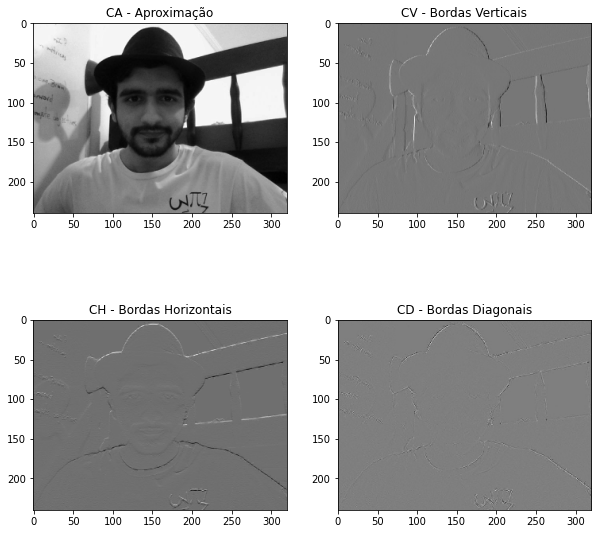




RODANDO A FUNÇÃO: calcular_mse_peb
MSE_Y = 5.44e-13
PSNR_Luma = 170.78 dB



RODANDO A FUNÇÃO: plotar_reconstrucao


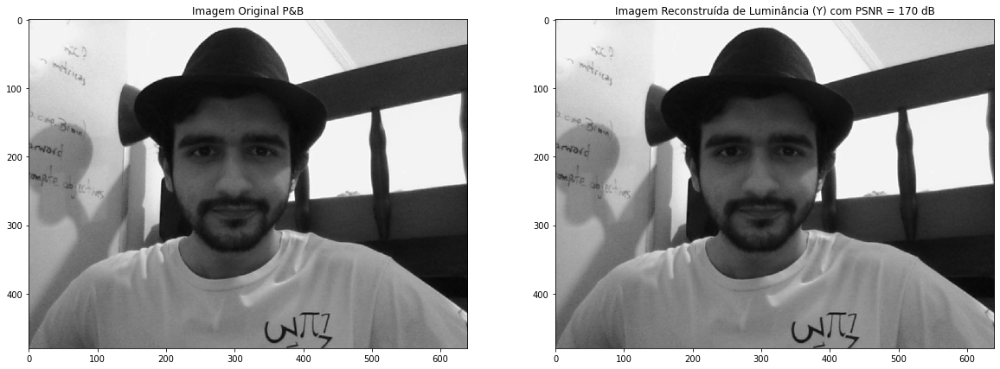




RODANDO A FUNÇÃO: dwt_idwt_2



RODANDO A FUNÇÃO: plotar_coefs_2


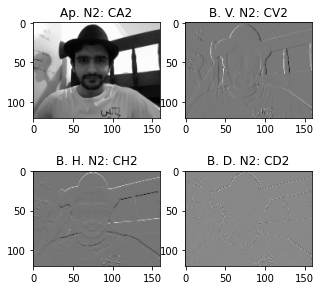




RODANDO A FUNÇÃO: plotar_reconstrucao_2


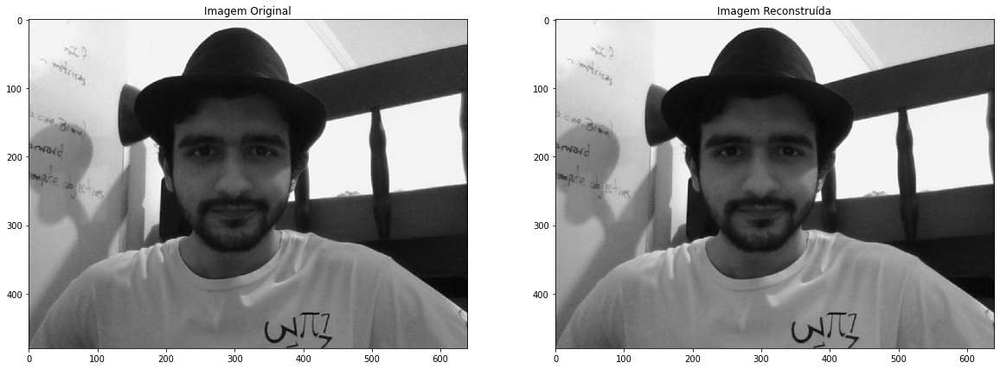




RODANDO A FUNÇÃO: obter_matriz_final



RODANDO A FUNÇÃO: plotar_wavedec2


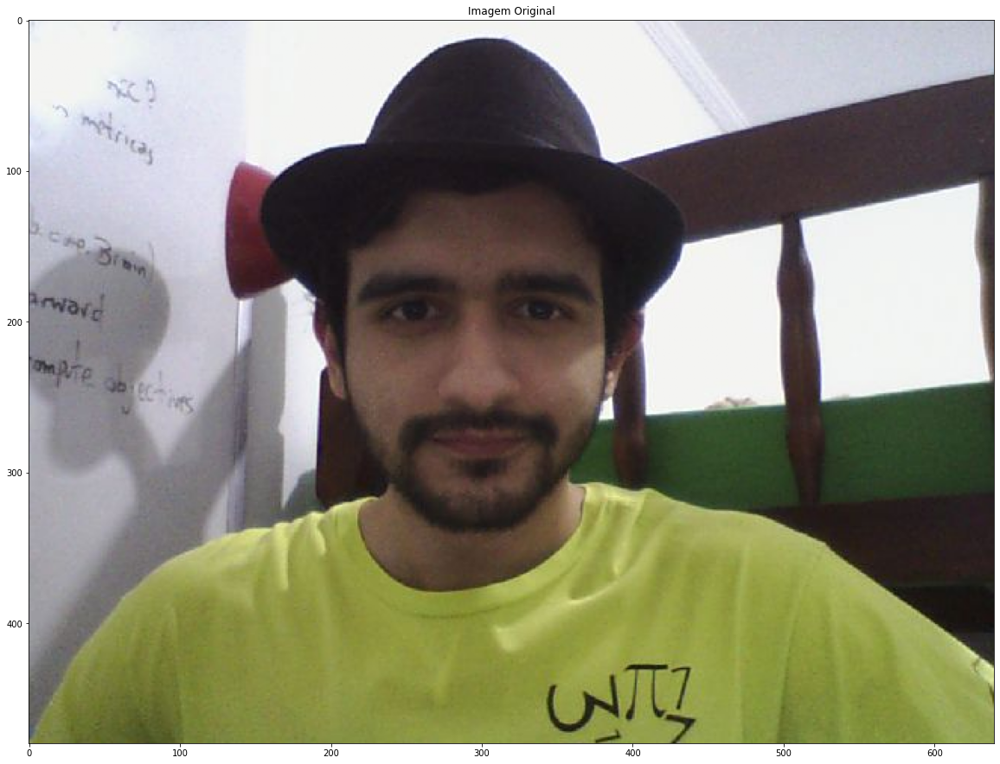




RODANDO A FUNÇÃO: codificar_por_cores



RODANDO A FUNÇÃO: plotar_por_cores



RODANDO A FUNÇÃO: plotar_vermelho


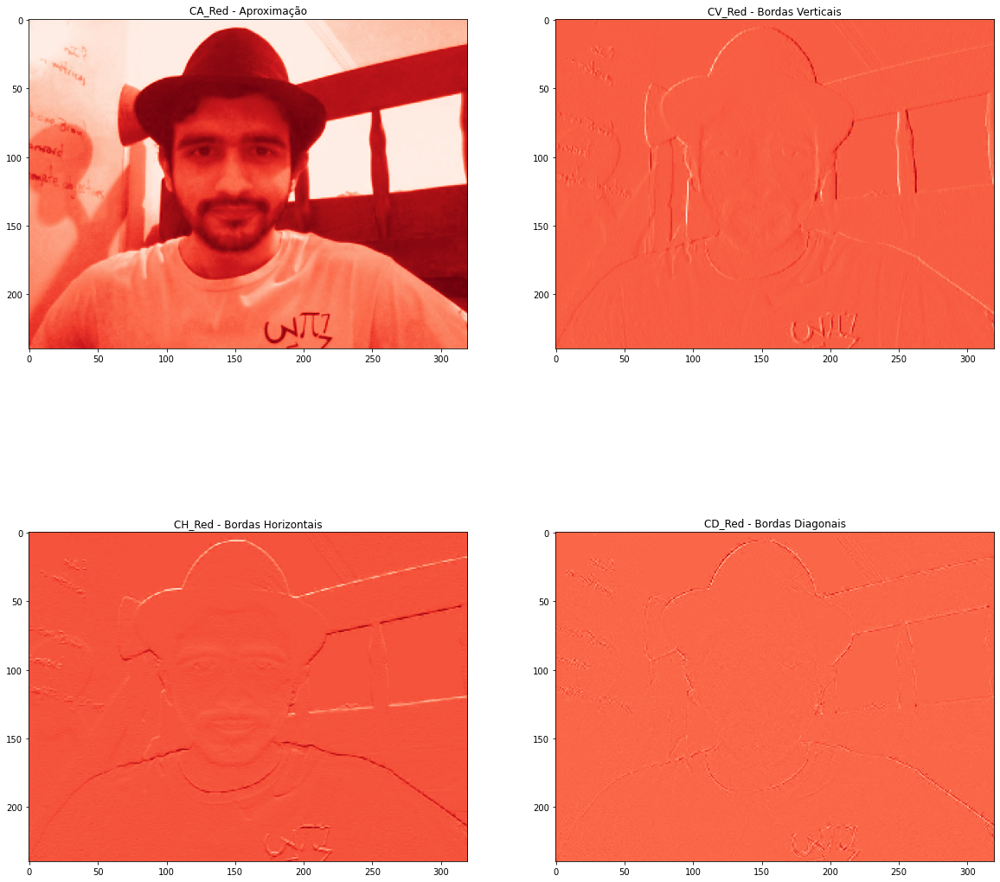

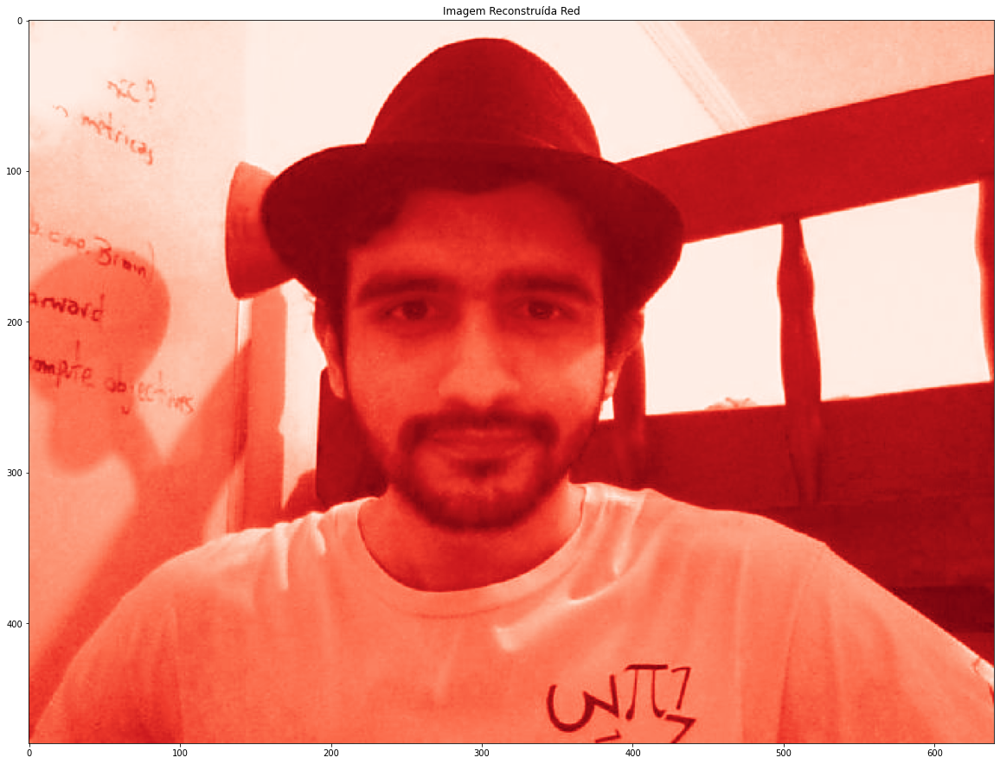




RODANDO A FUNÇÃO: plotar_verde


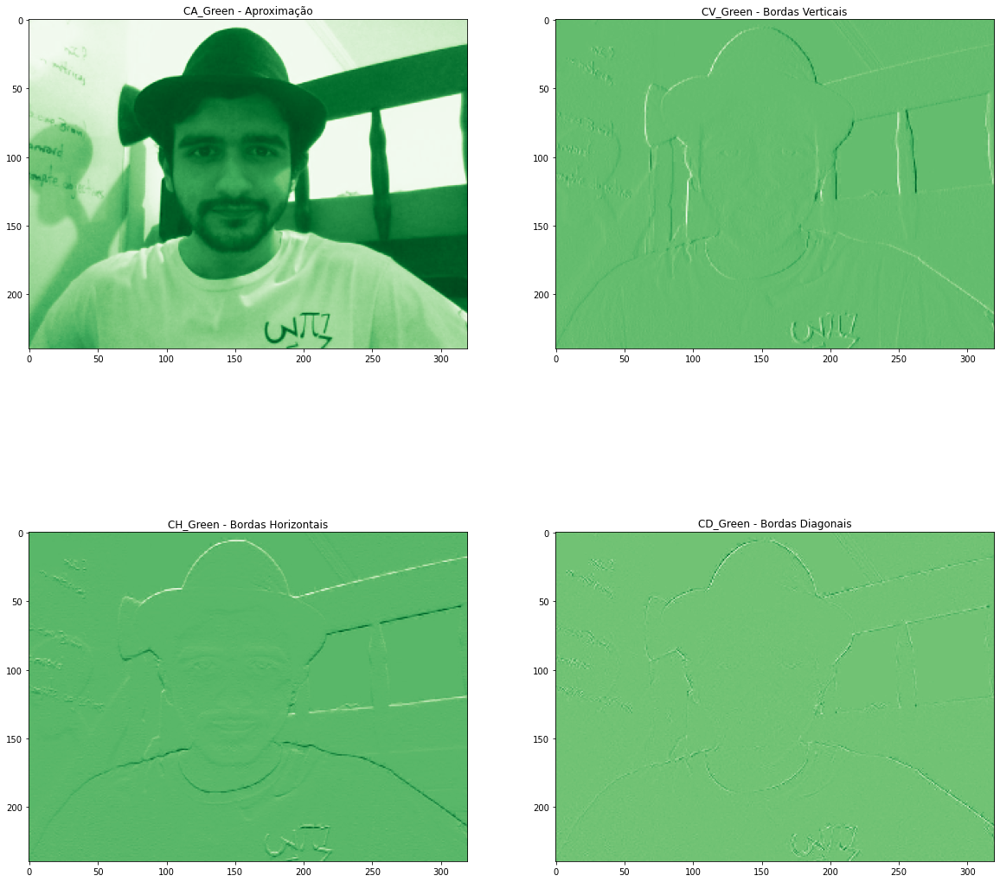

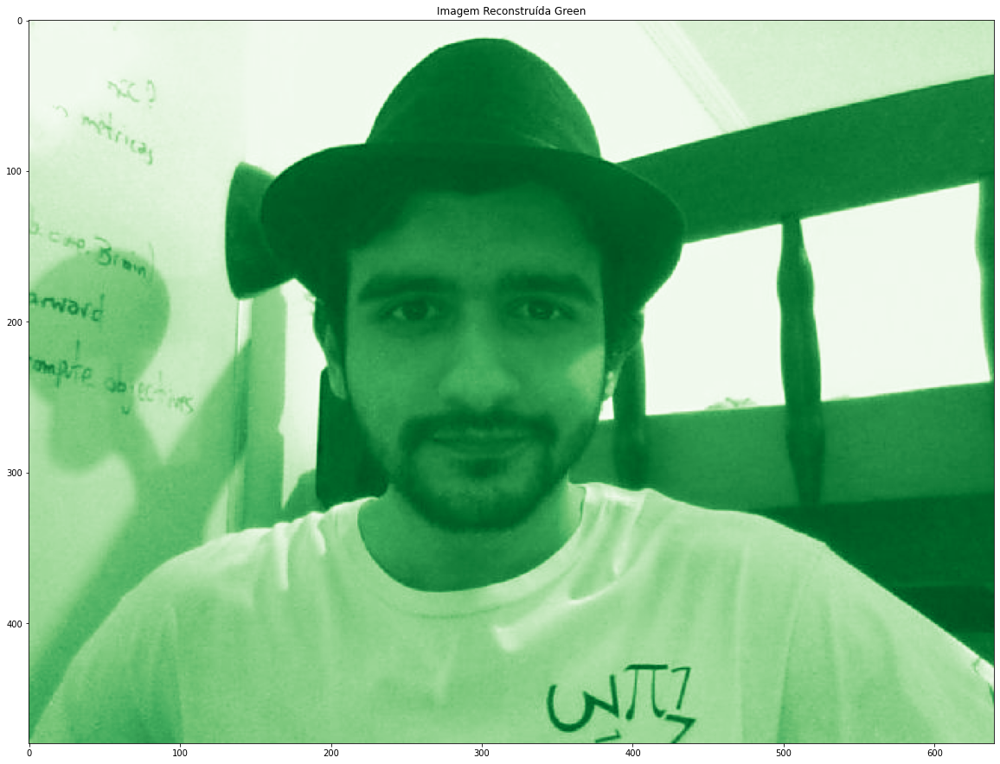




RODANDO A FUNÇÃO: plotar_azul


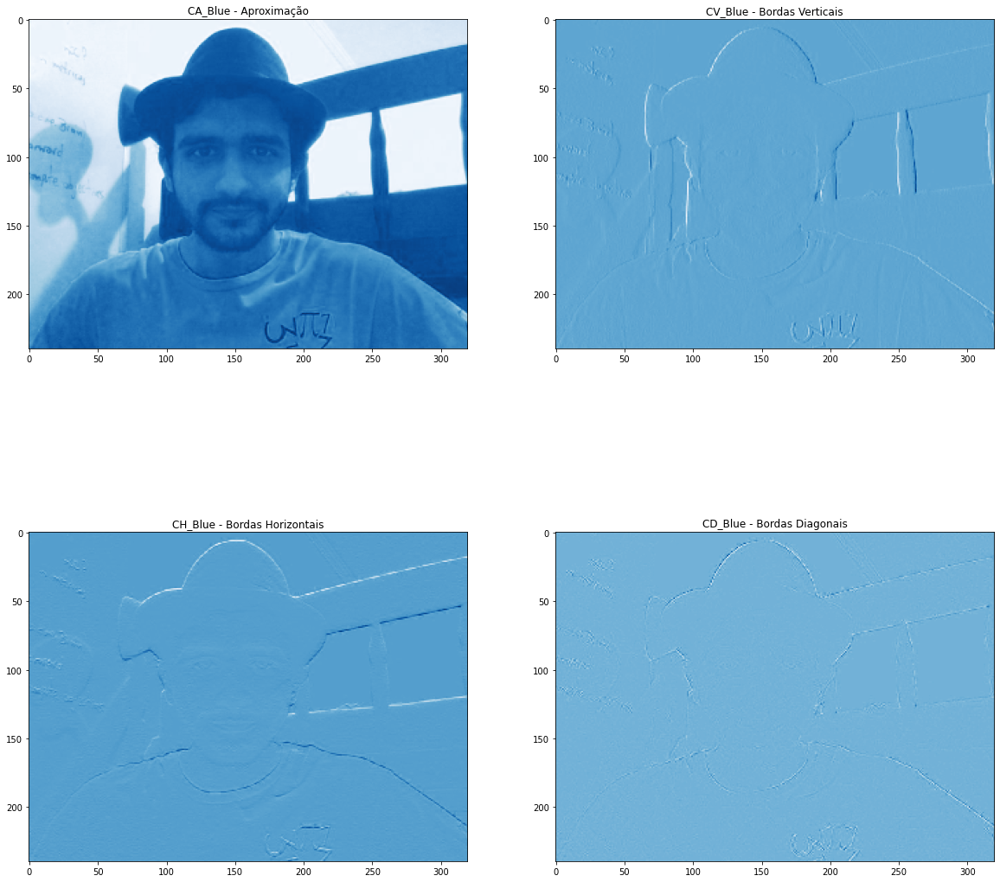

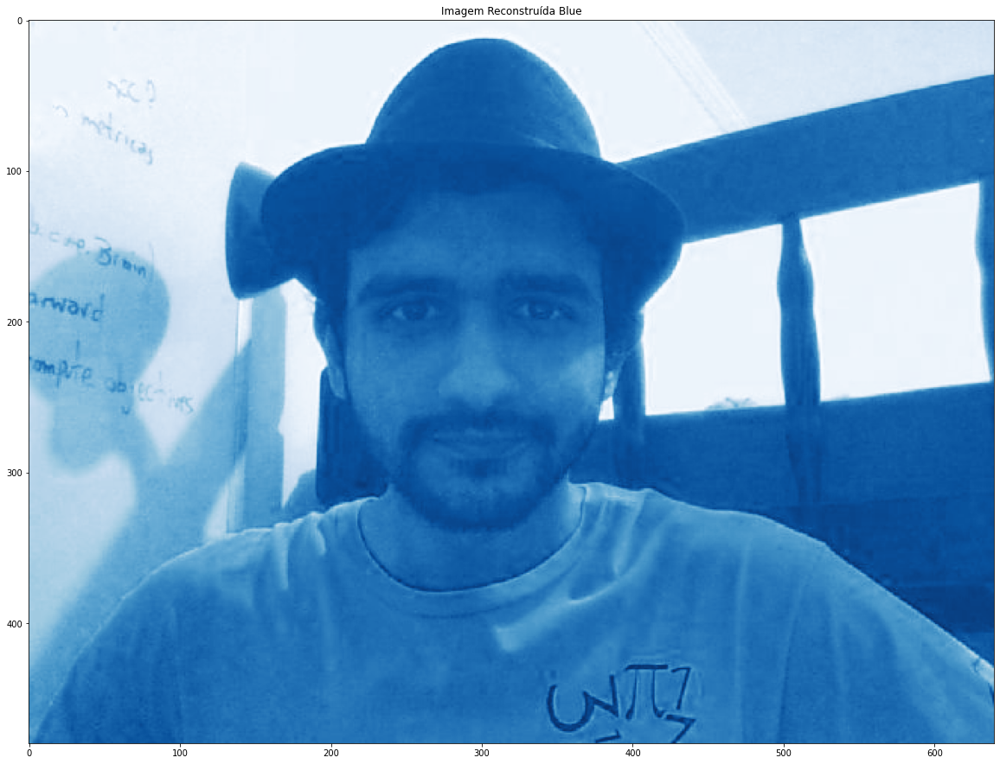

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).





RODANDO A FUNÇÃO: reconstruir_nivel_1



RODANDO A FUNÇÃO: plotar_nivel_1


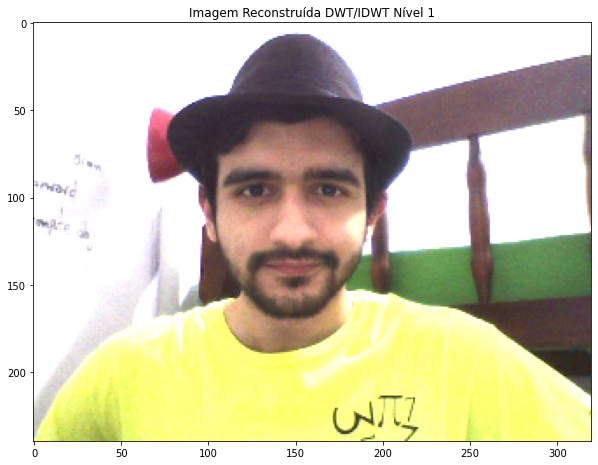




RODANDO A FUNÇÃO: reconstrucao_colorida_original



RODANDO A FUNÇÃO: calcular_mse_colorida


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


MSE_Red= 3.93e-13  MSE_Green= 3.81e-13  MSE_Blue= 3.10e-13



RODANDO A FUNÇÃO: calcular_snr_pico_colorida
PSNR total = 167.78 dB



RODANDO A FUNÇÃO: plotar_psnr


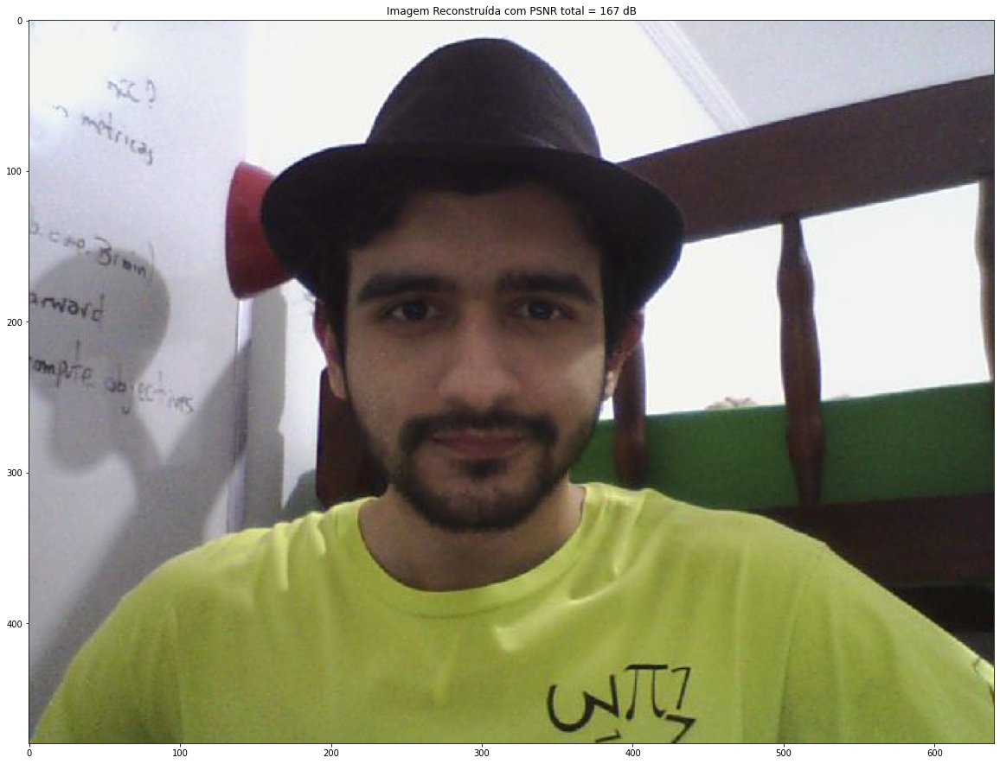

In [33]:
dirLab4 = dirGit.joinpath('lab4/imagens/')
data.append(main(dirLab4.joinpath('matheus.png')))

### Dimitri




RODANDO A FUNÇÃO: main



RODANDO A FUNÇÃO: abrir_imagem



RODANDO A FUNÇÃO: converter_cinza



RODANDO A FUNÇÃO: dwt_idwt



RODANDO A FUNÇÃO: plotar_coefs


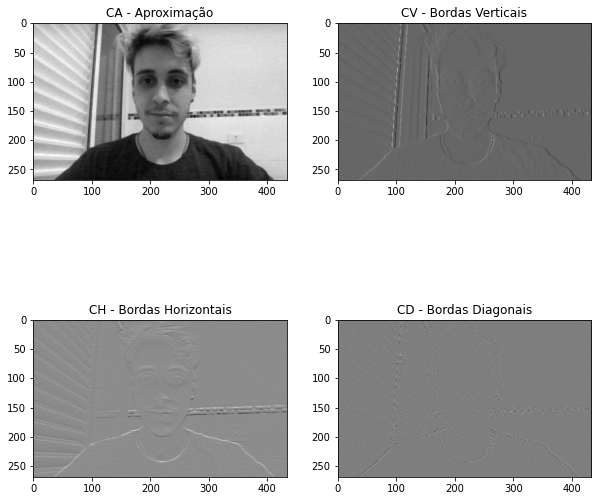




RODANDO A FUNÇÃO: calcular_mse_peb
MSE_Y = 8.23e-13
PSNR_Luma = 168.97 dB



RODANDO A FUNÇÃO: plotar_reconstrucao


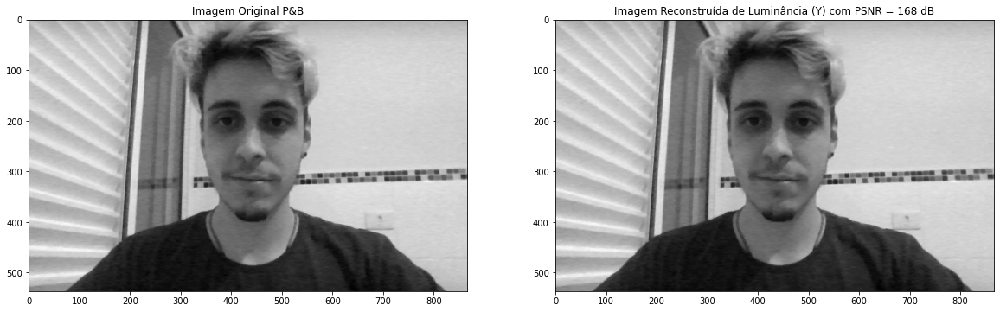




RODANDO A FUNÇÃO: dwt_idwt_2



RODANDO A FUNÇÃO: plotar_coefs_2


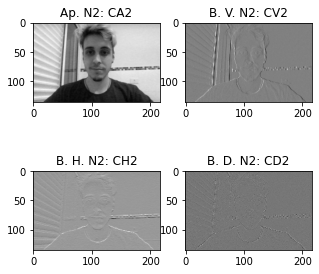




RODANDO A FUNÇÃO: plotar_reconstrucao_2


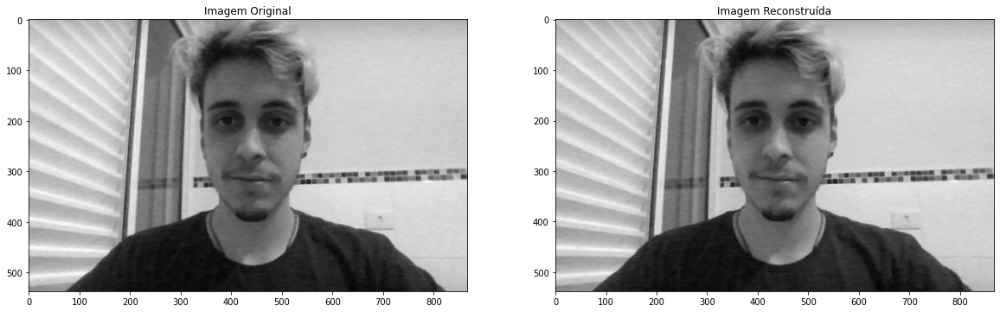




RODANDO A FUNÇÃO: obter_matriz_final



RODANDO A FUNÇÃO: plotar_wavedec2


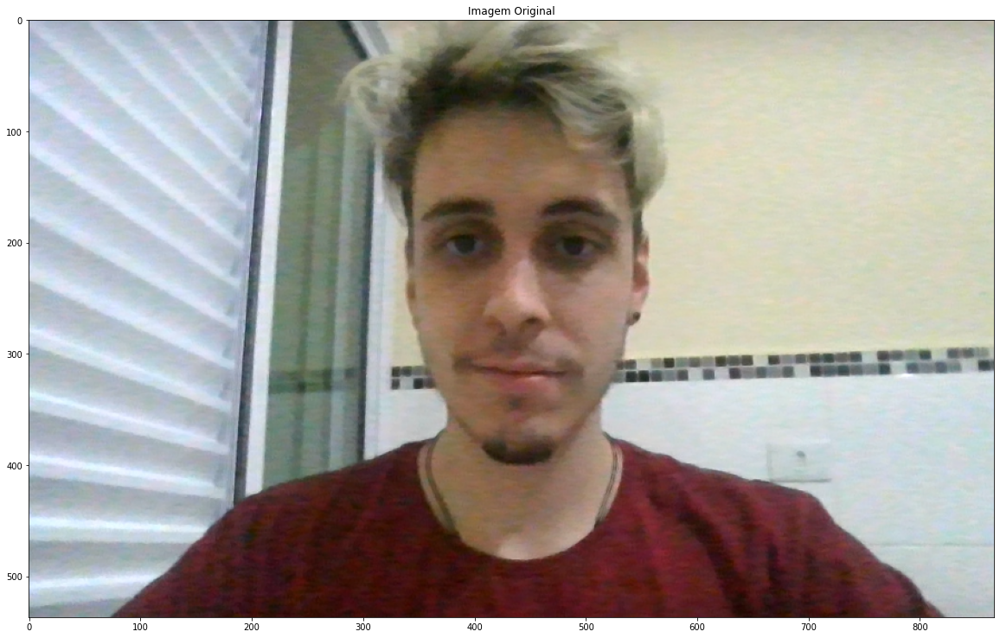




RODANDO A FUNÇÃO: codificar_por_cores



RODANDO A FUNÇÃO: plotar_por_cores



RODANDO A FUNÇÃO: plotar_vermelho


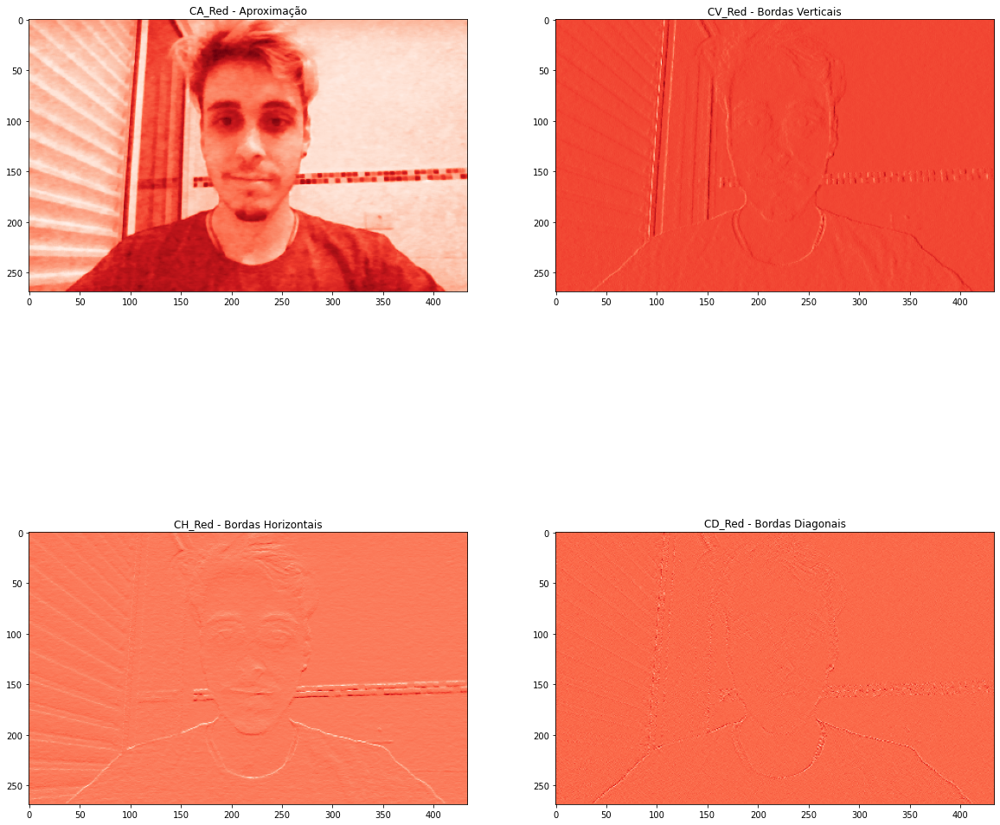

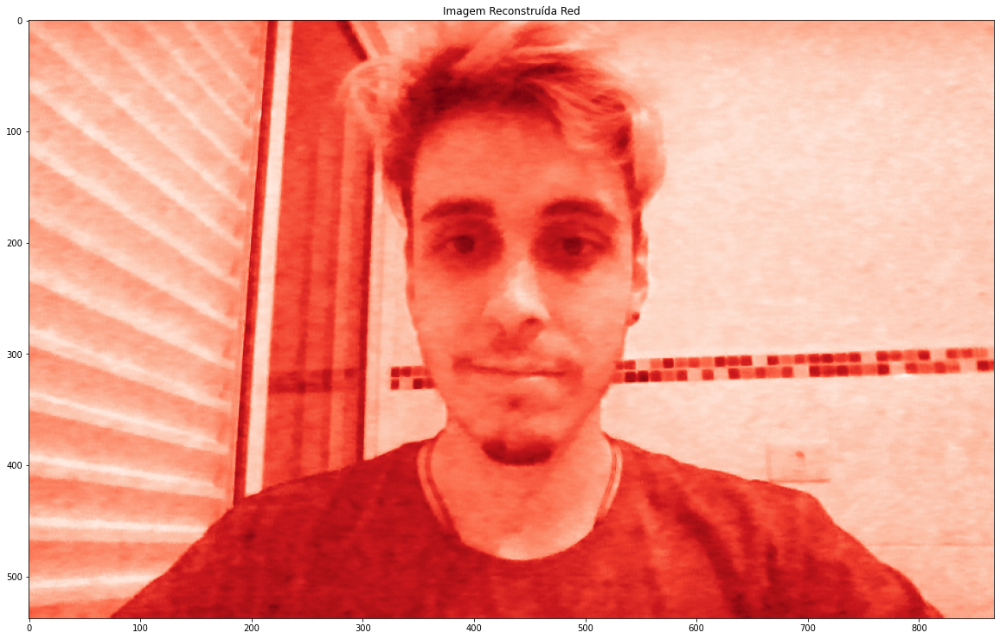




RODANDO A FUNÇÃO: plotar_verde


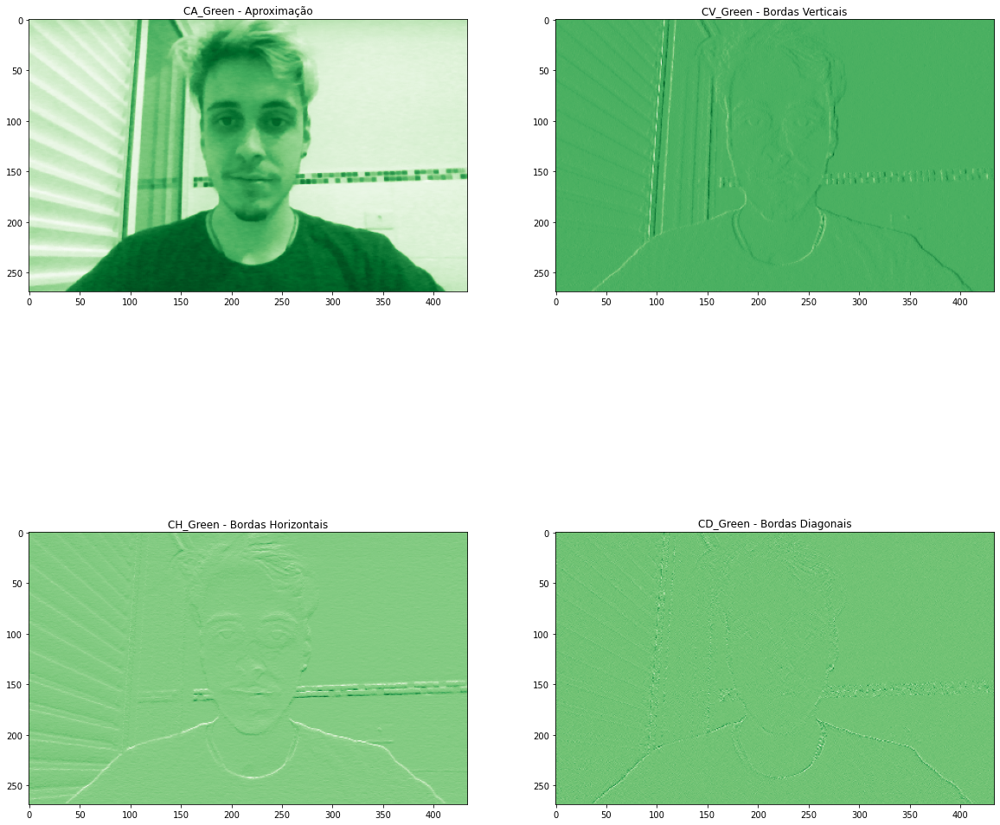

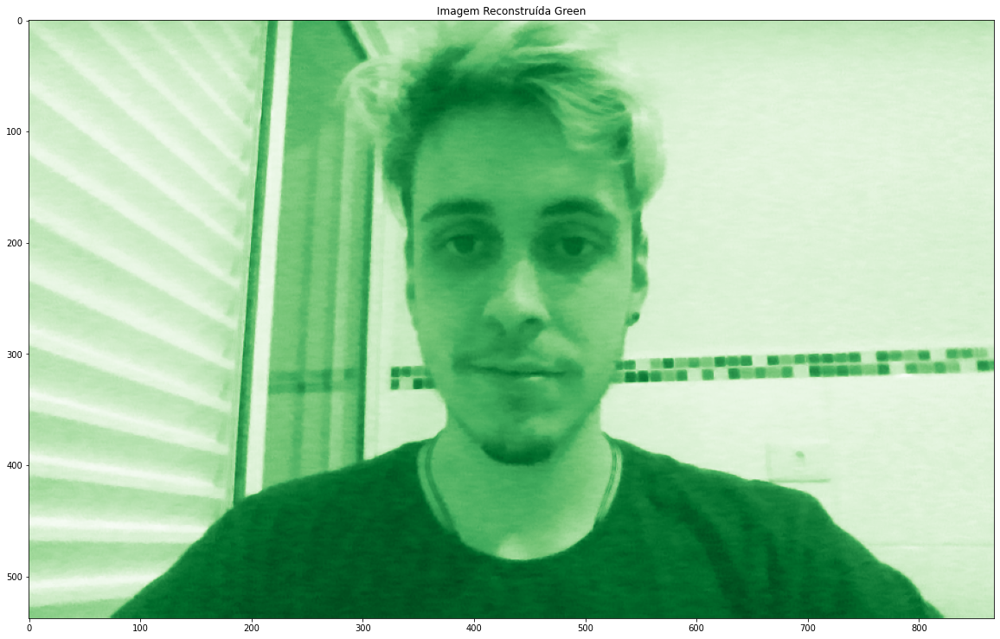




RODANDO A FUNÇÃO: plotar_azul


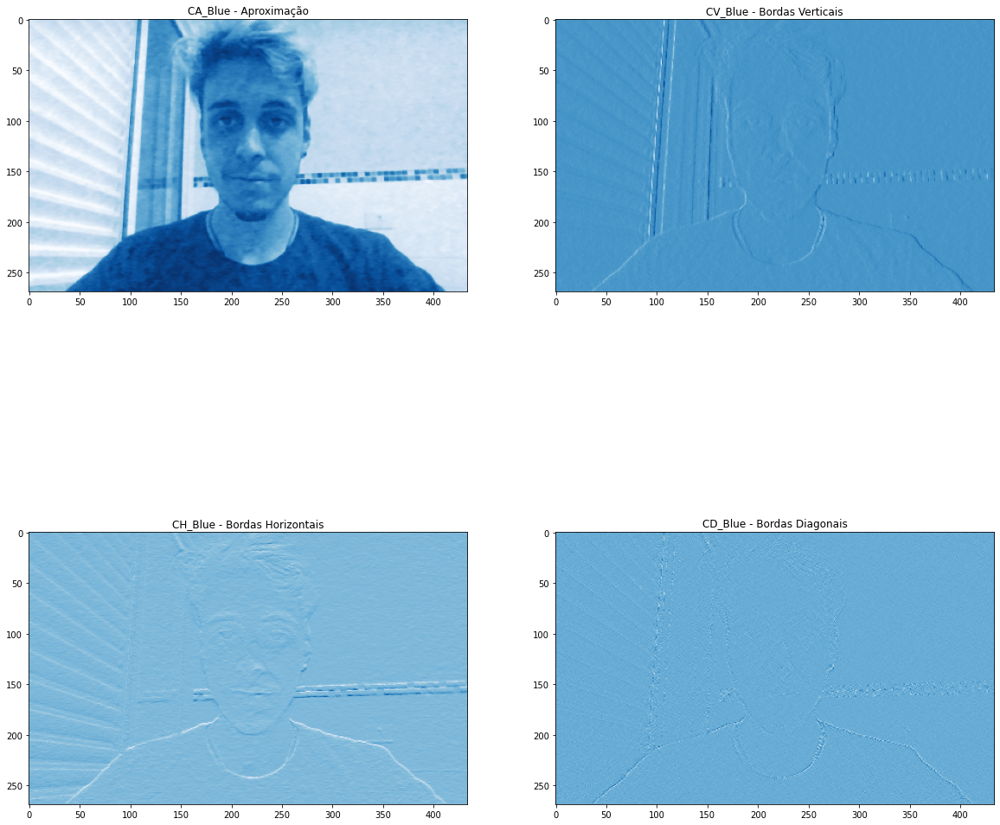

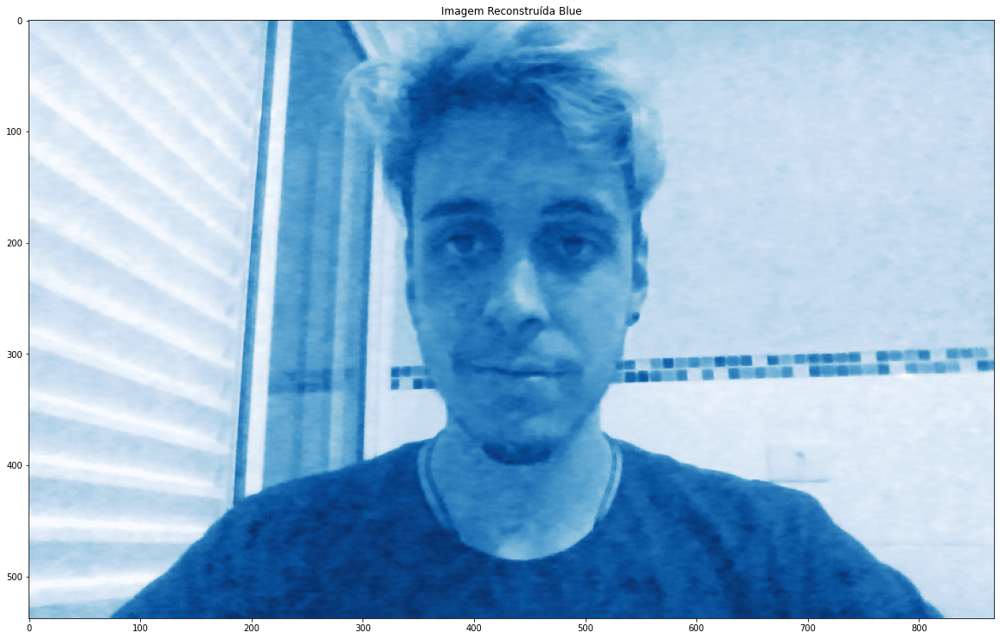

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).





RODANDO A FUNÇÃO: reconstruir_nivel_1



RODANDO A FUNÇÃO: plotar_nivel_1


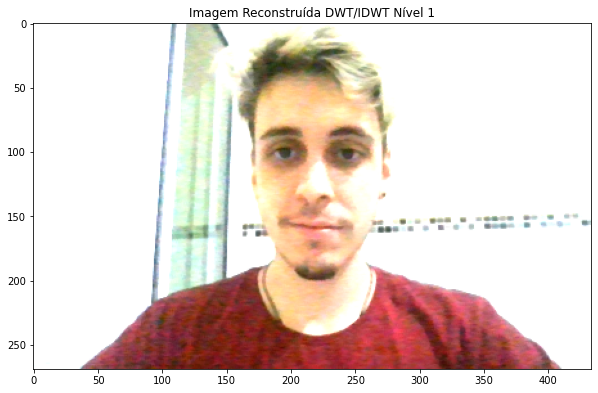




RODANDO A FUNÇÃO: reconstrucao_colorida_original



RODANDO A FUNÇÃO: calcular_mse_colorida


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


MSE_Red= 7.85e-13  MSE_Green= 7.23e-13  MSE_Blue= 9.03e-13



RODANDO A FUNÇÃO: calcular_snr_pico_colorida
PSNR total = 164.31 dB



RODANDO A FUNÇÃO: plotar_psnr


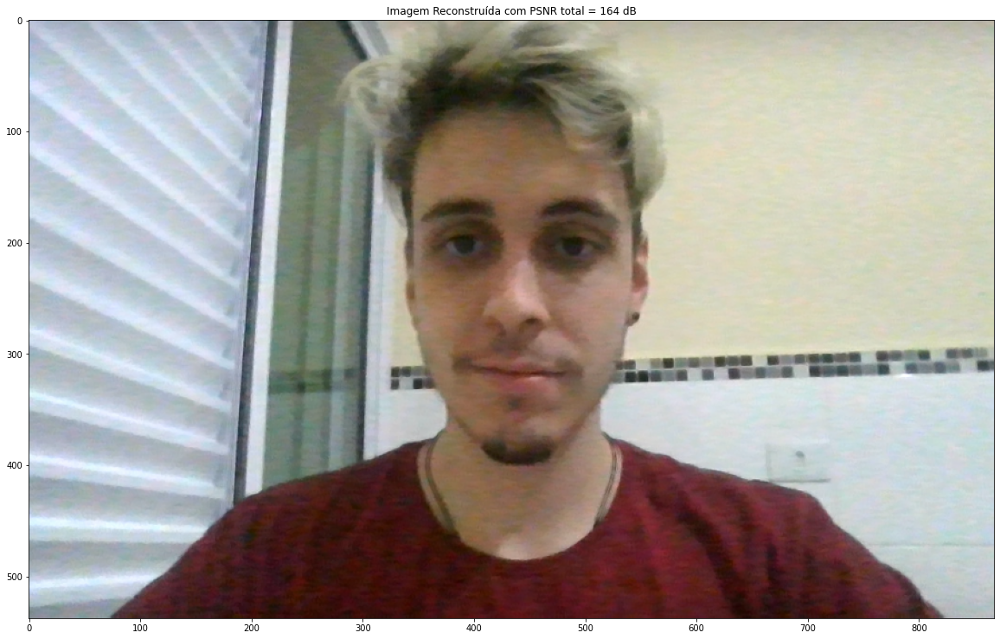

In [34]:
dirLab4 = dirGit.joinpath('lab4/imagens/')
data.append(main(dirLab4.joinpath('dimitri.png')))

### William




RODANDO A FUNÇÃO: main



RODANDO A FUNÇÃO: abrir_imagem



RODANDO A FUNÇÃO: converter_cinza



RODANDO A FUNÇÃO: dwt_idwt



RODANDO A FUNÇÃO: plotar_coefs


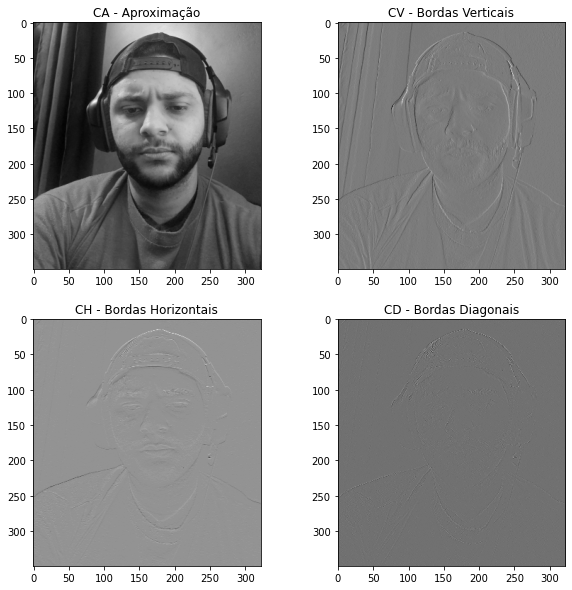




RODANDO A FUNÇÃO: calcular_mse_peb
MSE_Y = 4.37e-13
PSNR_Luma = 171.72 dB



RODANDO A FUNÇÃO: plotar_reconstrucao


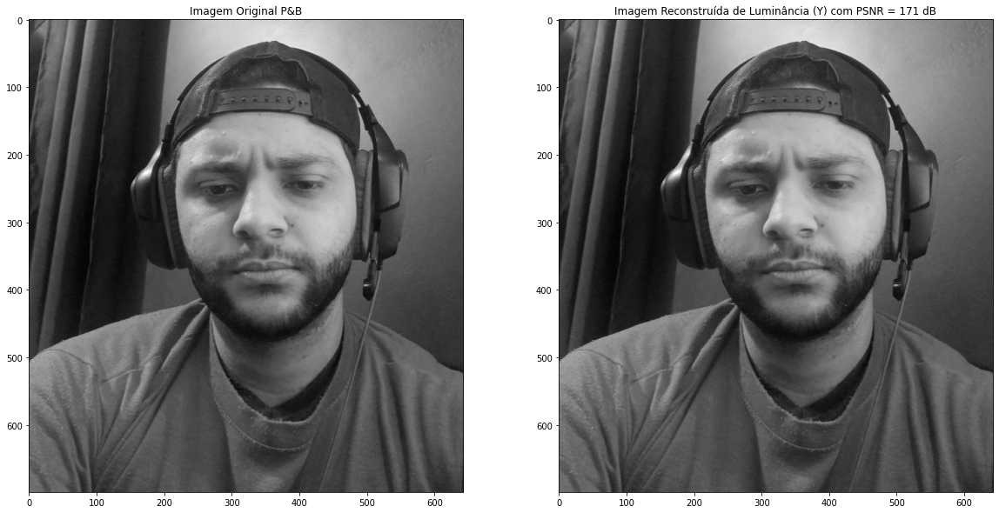




RODANDO A FUNÇÃO: dwt_idwt_2



RODANDO A FUNÇÃO: plotar_coefs_2


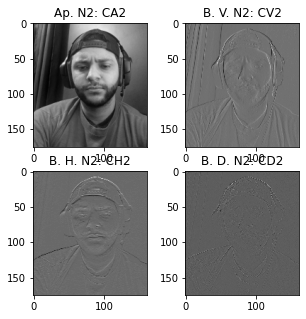




RODANDO A FUNÇÃO: plotar_reconstrucao_2


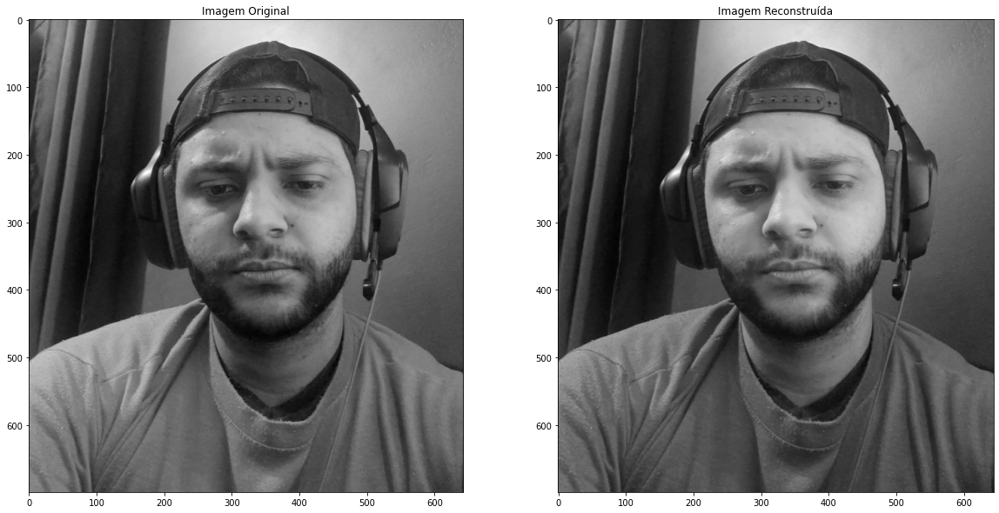




RODANDO A FUNÇÃO: obter_matriz_final



RODANDO A FUNÇÃO: plotar_wavedec2


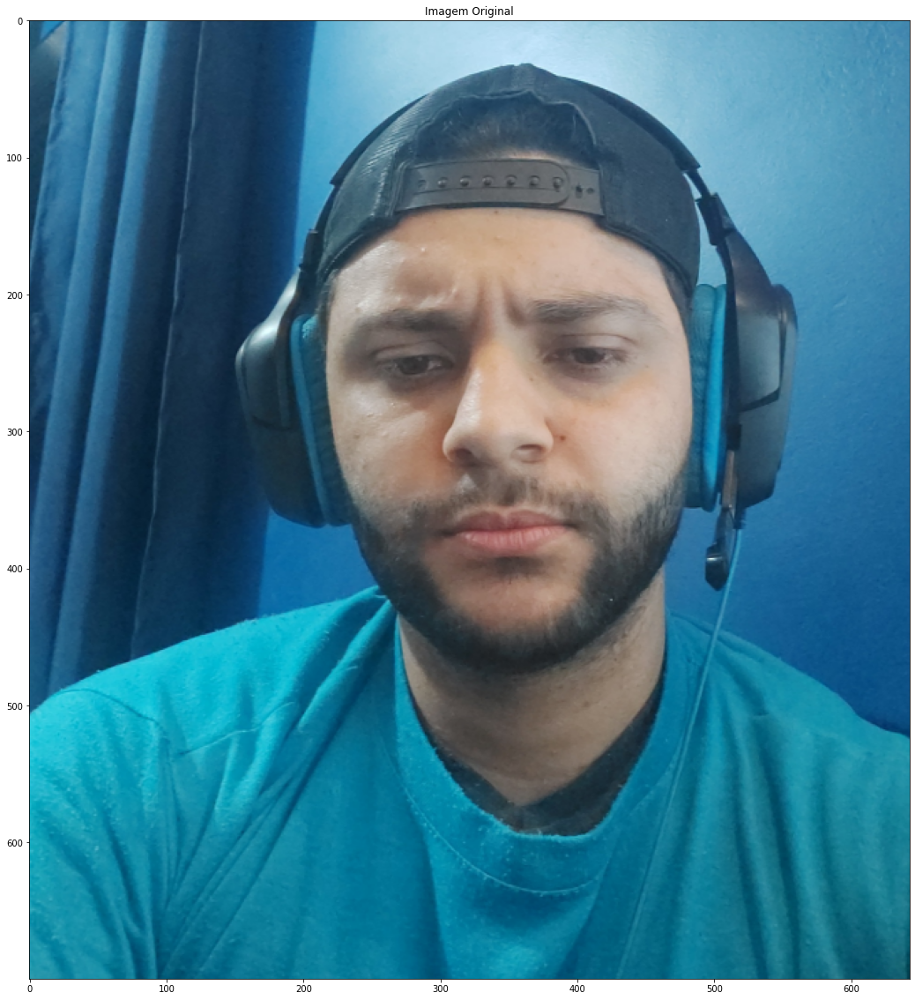




RODANDO A FUNÇÃO: codificar_por_cores



RODANDO A FUNÇÃO: plotar_por_cores



RODANDO A FUNÇÃO: plotar_vermelho


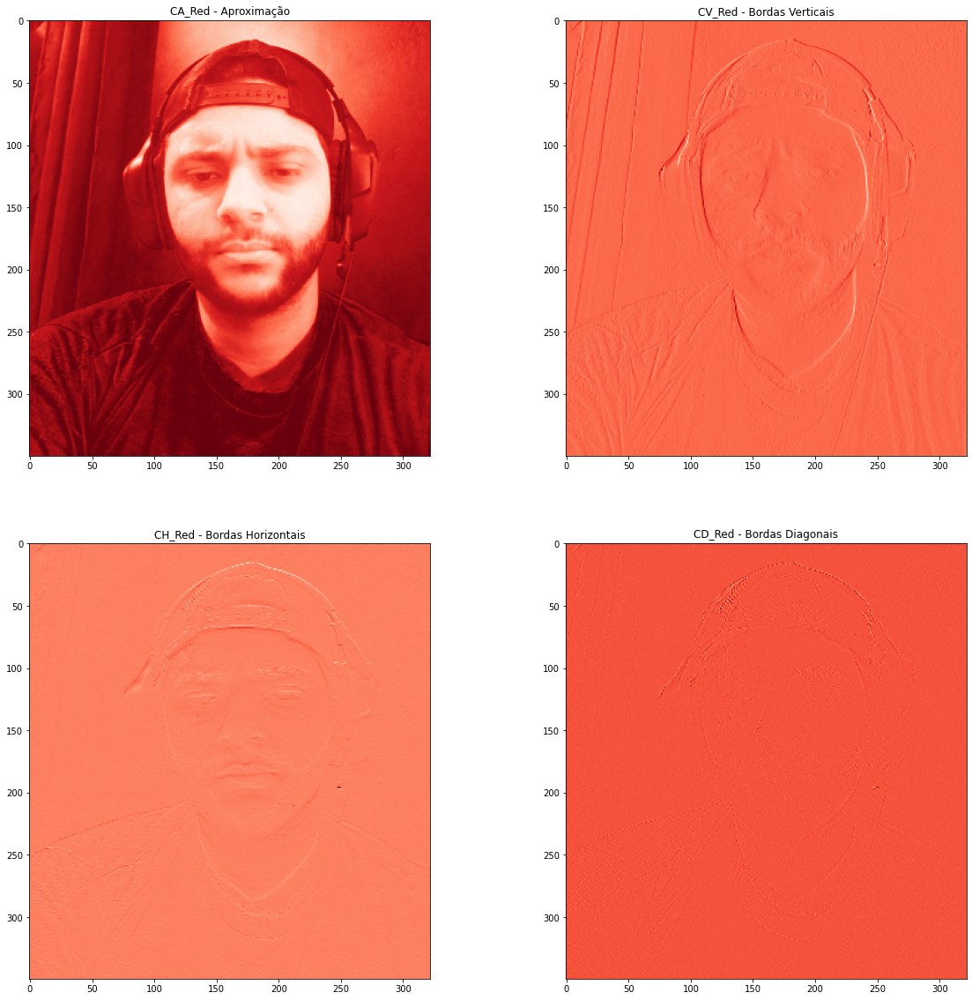

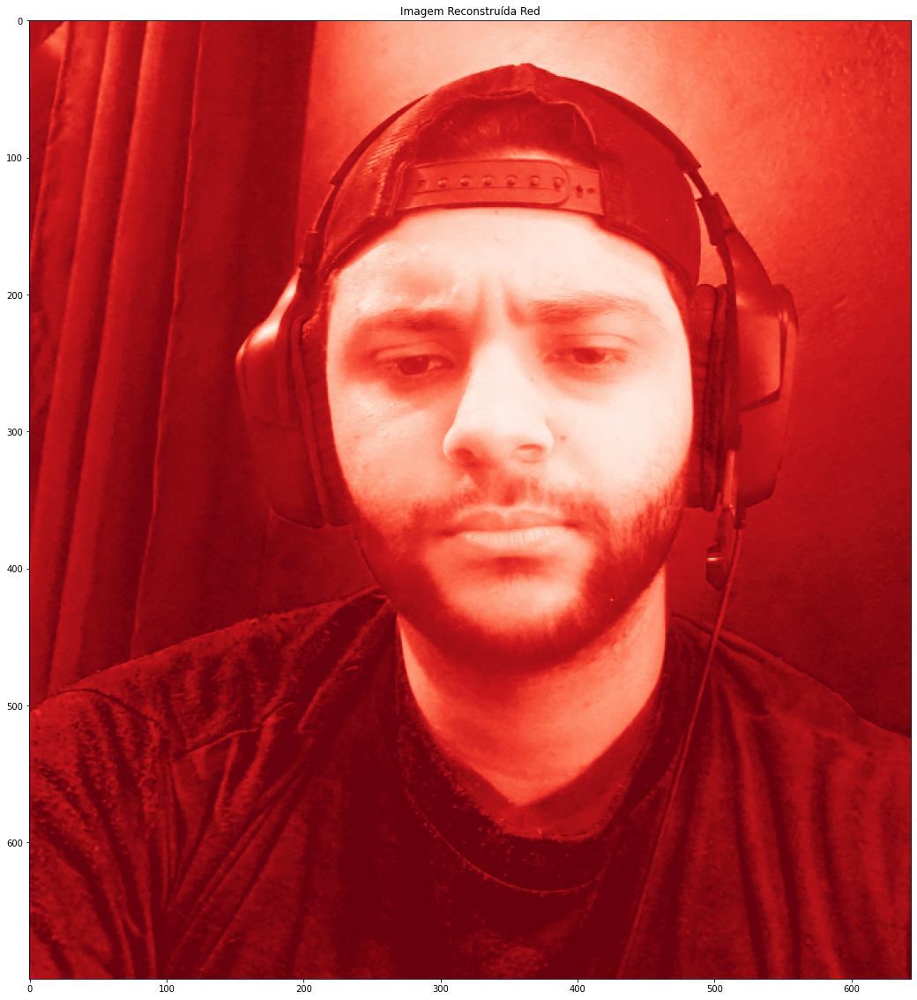




RODANDO A FUNÇÃO: plotar_verde


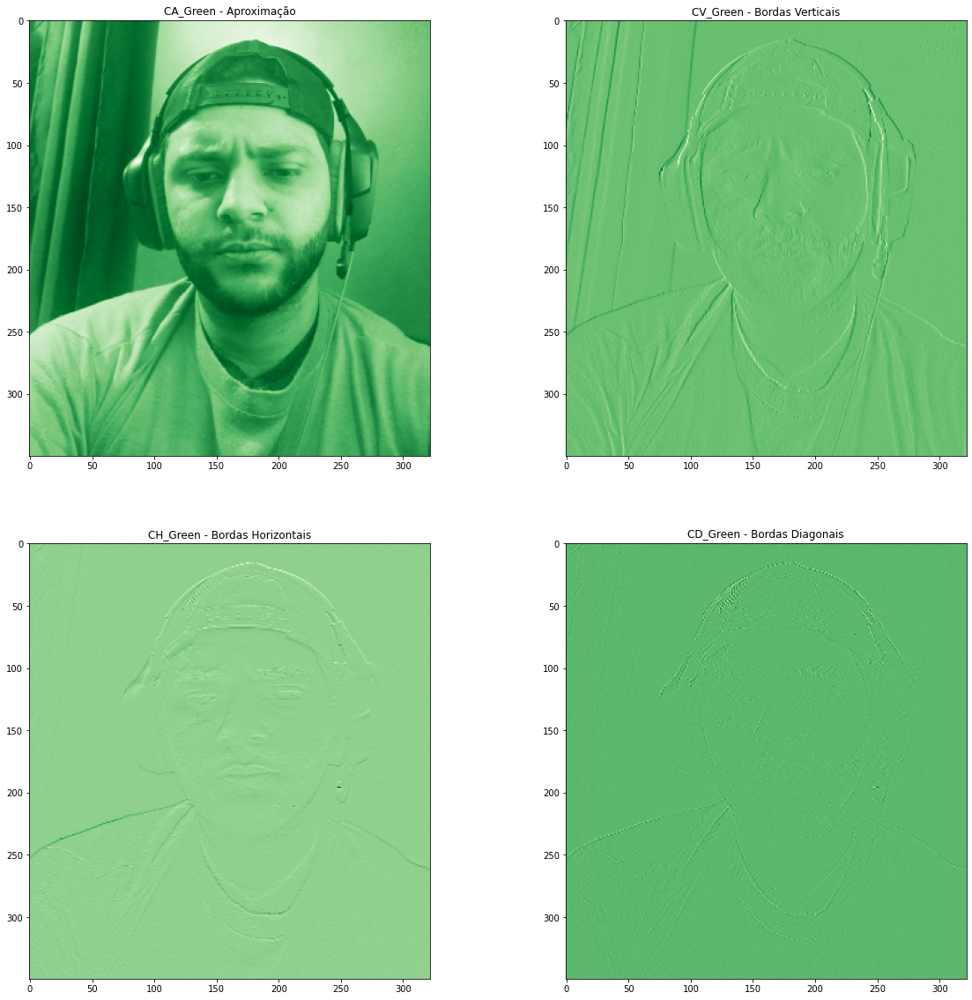

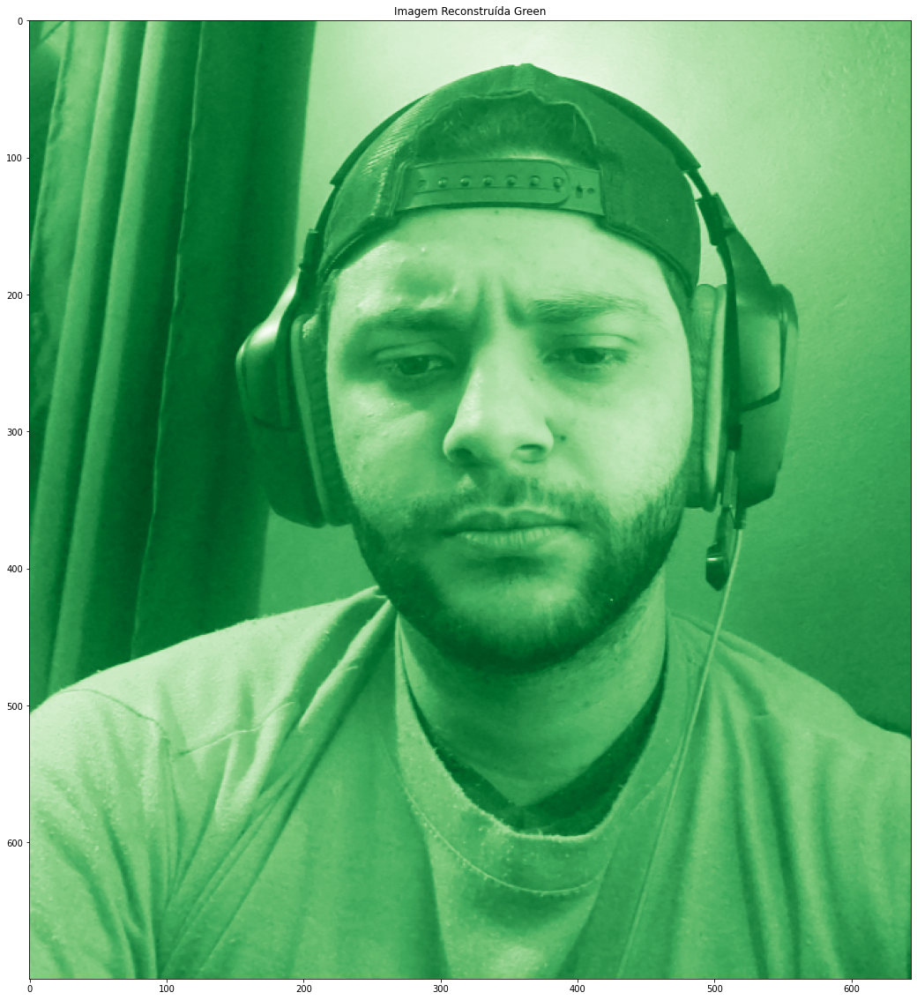




RODANDO A FUNÇÃO: plotar_azul


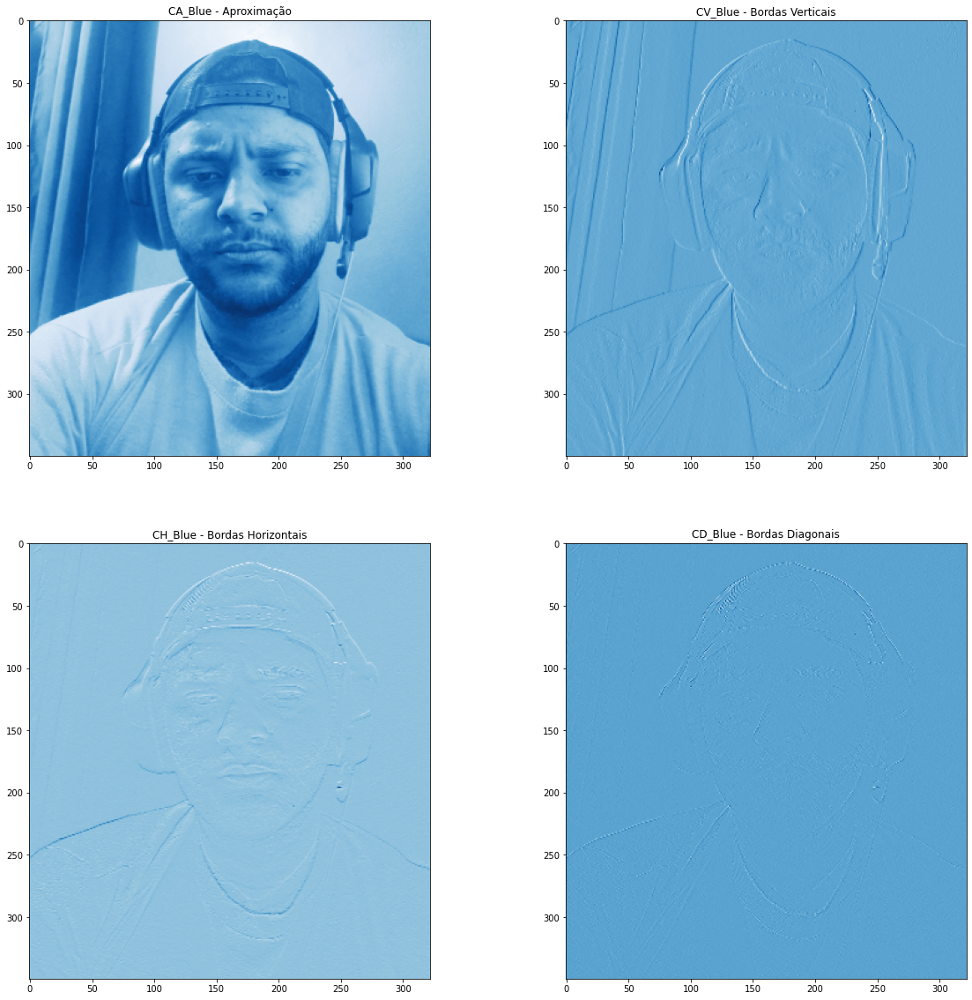

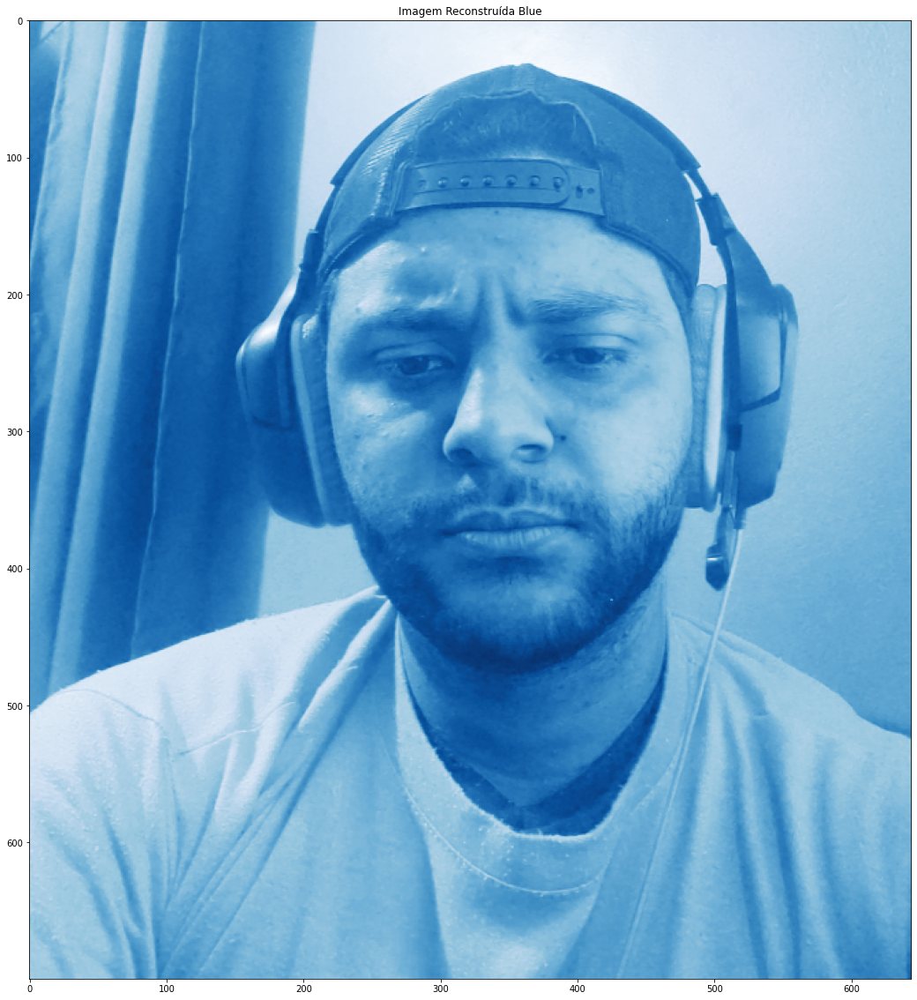

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).





RODANDO A FUNÇÃO: reconstruir_nivel_1



RODANDO A FUNÇÃO: plotar_nivel_1


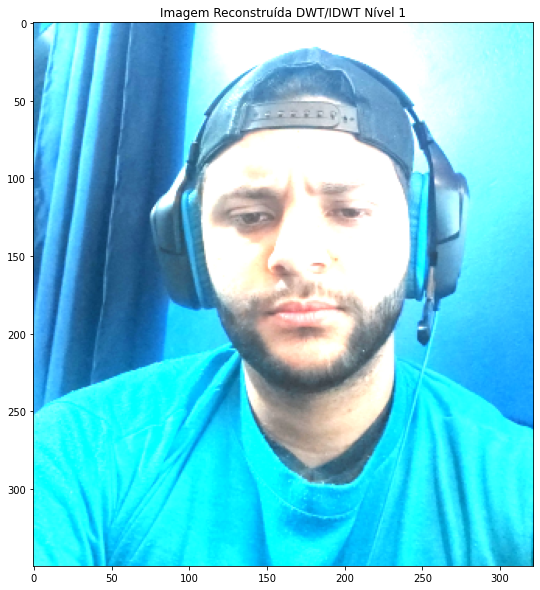




RODANDO A FUNÇÃO: reconstrucao_colorida_original



RODANDO A FUNÇÃO: calcular_mse_colorida


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


MSE_Red= 1.83e-13  MSE_Green= 5.42e-13  MSE_Blue= 7.55e-13



RODANDO A FUNÇÃO: calcular_snr_pico_colorida
PSNR total = 166.43 dB



RODANDO A FUNÇÃO: plotar_psnr


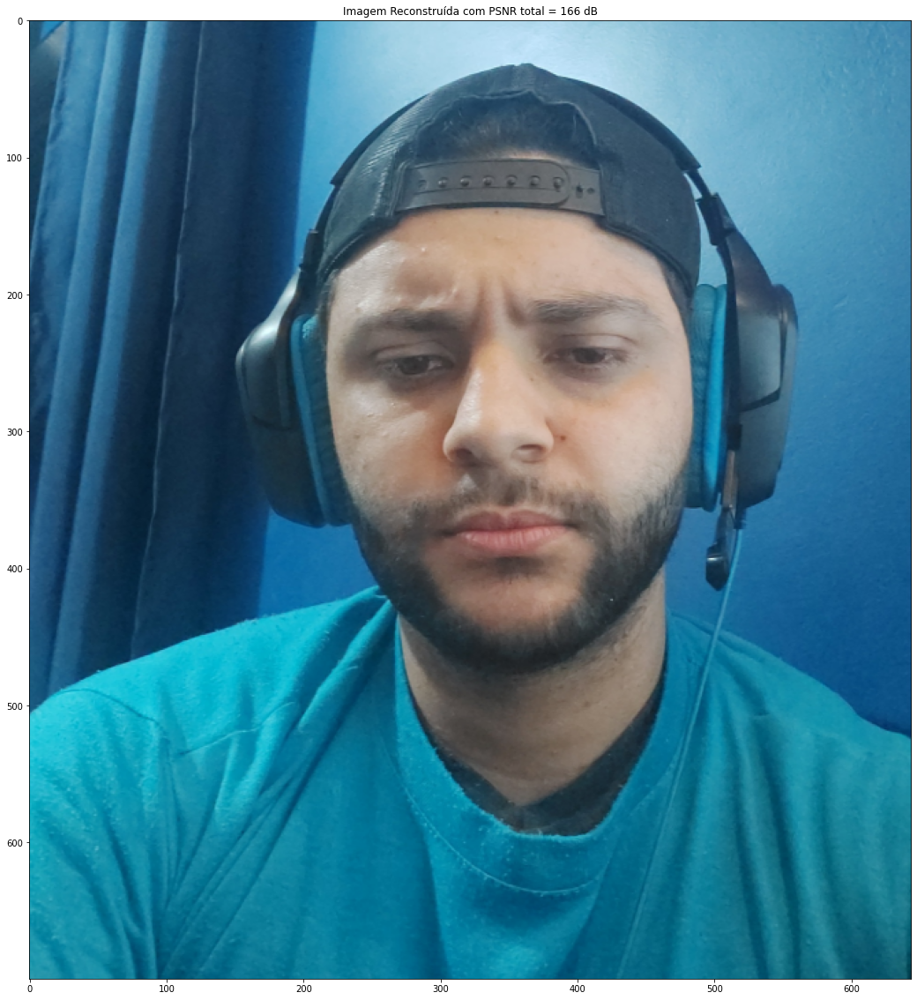

In [35]:
dirLab4 = dirGit.joinpath('lab4/imagens/')
data.append(main(dirLab4.joinpath('william.png')))




RODANDO A FUNÇÃO: main



RODANDO A FUNÇÃO: abrir_imagem



RODANDO A FUNÇÃO: converter_cinza



RODANDO A FUNÇÃO: dwt_idwt



RODANDO A FUNÇÃO: plotar_coefs


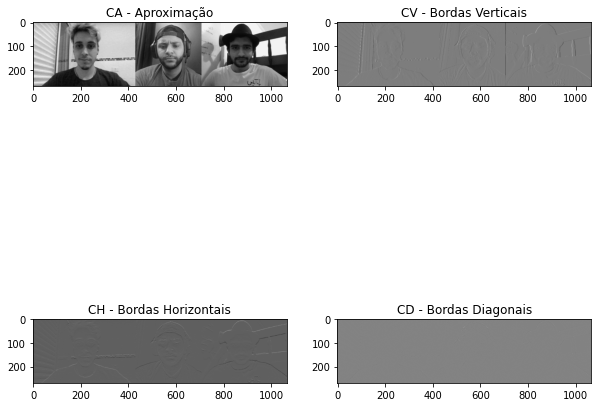




RODANDO A FUNÇÃO: calcular_mse_peb
MSE_Y = 6.35e-13
PSNR_Luma = 170.10 dB



RODANDO A FUNÇÃO: plotar_reconstrucao


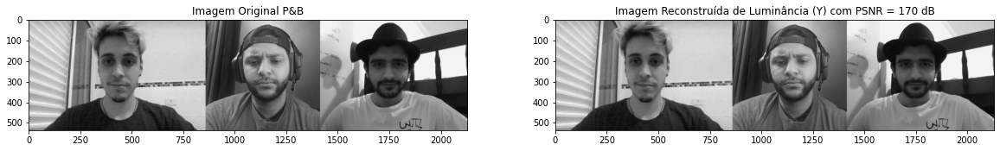




RODANDO A FUNÇÃO: dwt_idwt_2



RODANDO A FUNÇÃO: plotar_coefs_2


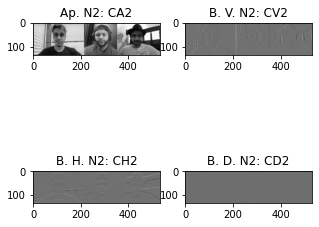




RODANDO A FUNÇÃO: plotar_reconstrucao_2


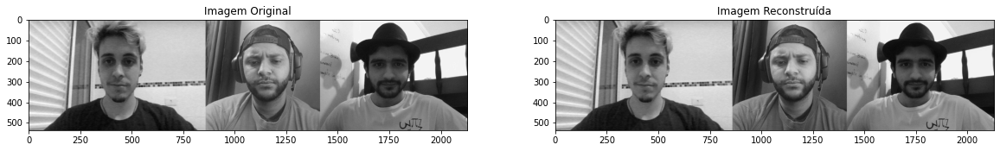




RODANDO A FUNÇÃO: obter_matriz_final



RODANDO A FUNÇÃO: plotar_wavedec2


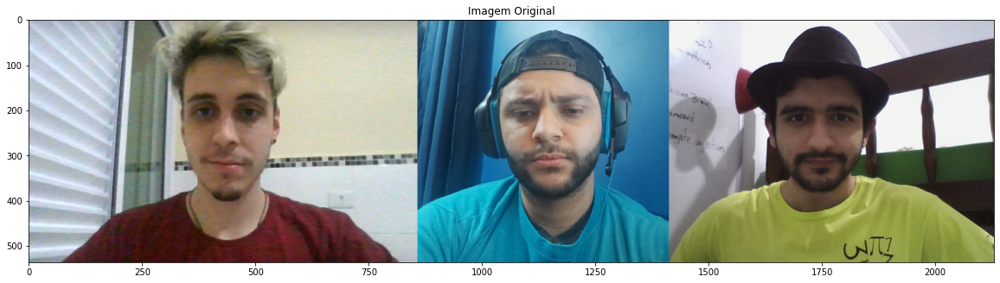




RODANDO A FUNÇÃO: codificar_por_cores



RODANDO A FUNÇÃO: plotar_por_cores



RODANDO A FUNÇÃO: plotar_vermelho


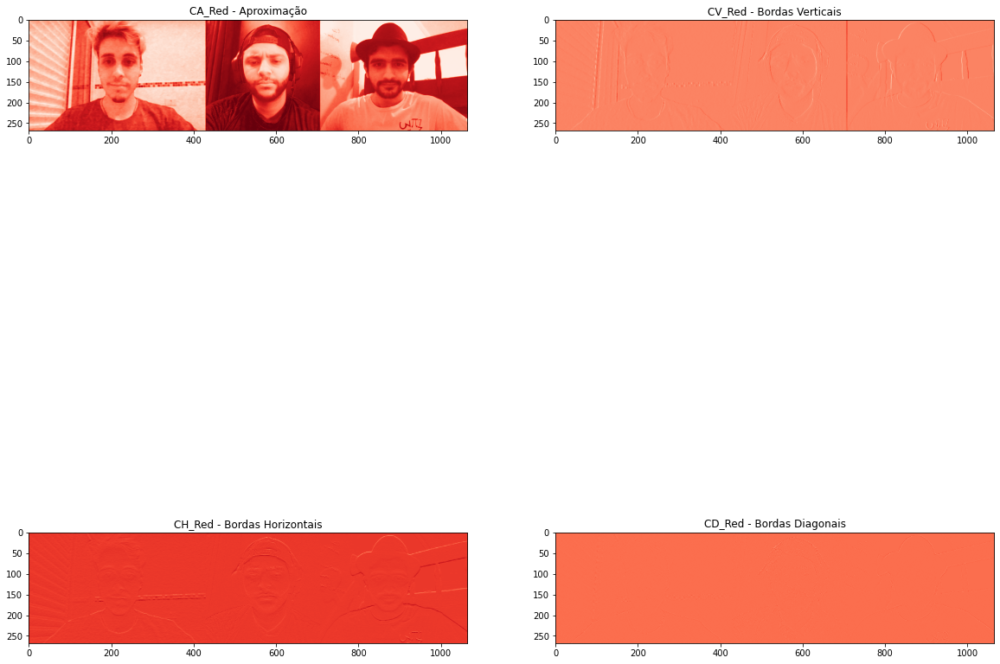

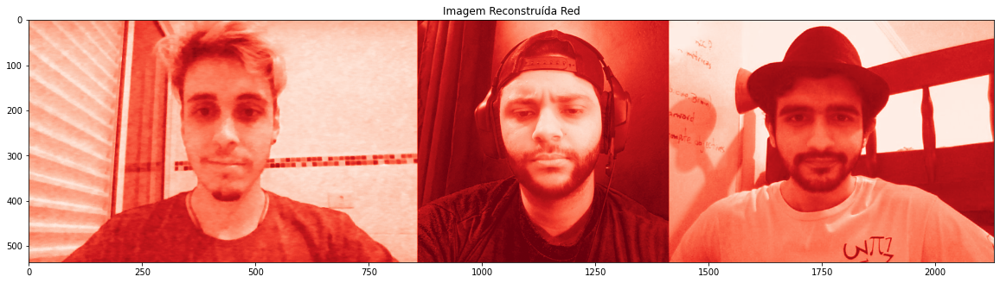




RODANDO A FUNÇÃO: plotar_verde


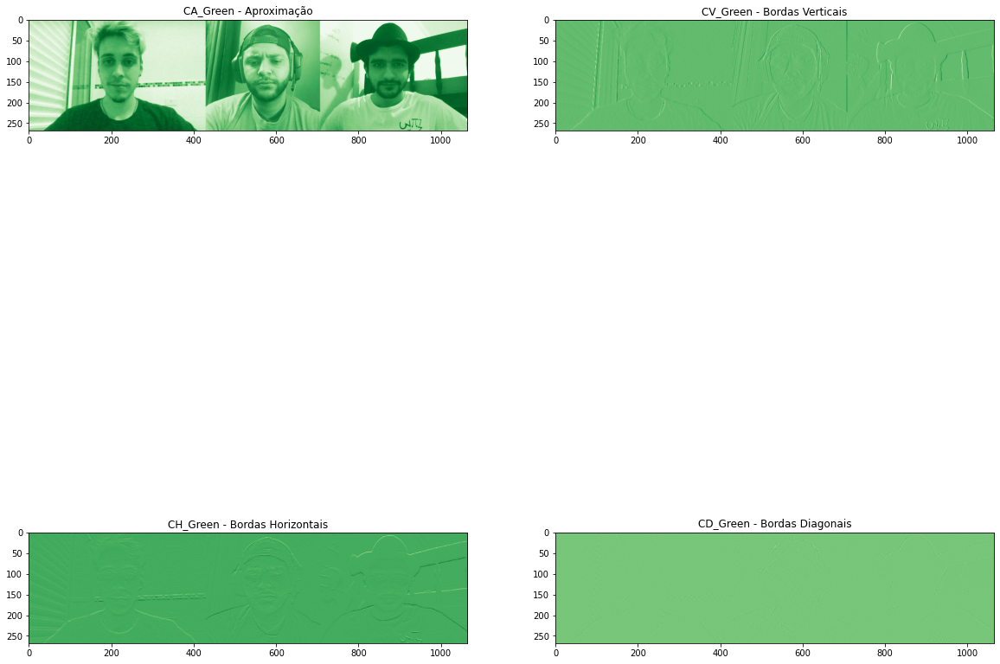

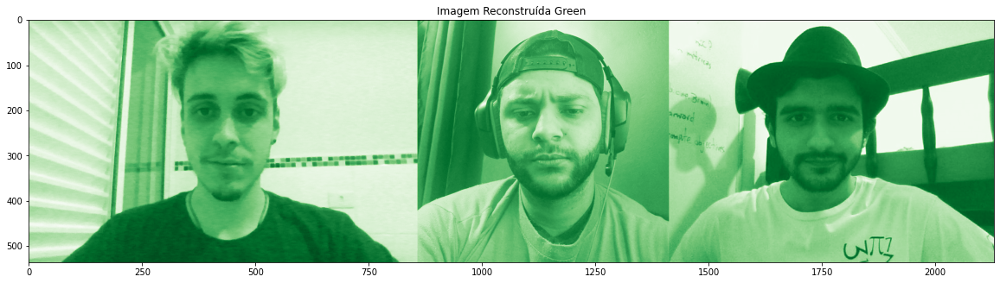




RODANDO A FUNÇÃO: plotar_azul


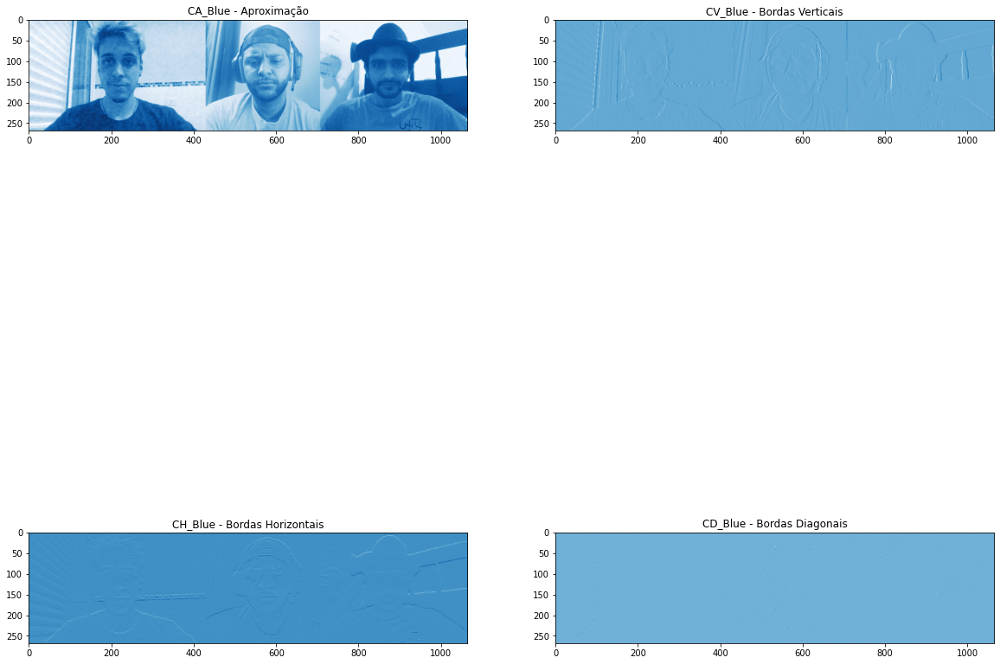

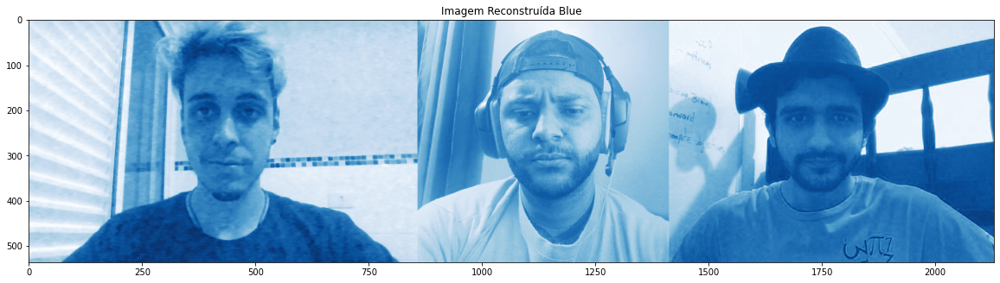

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).





RODANDO A FUNÇÃO: reconstruir_nivel_1



RODANDO A FUNÇÃO: plotar_nivel_1


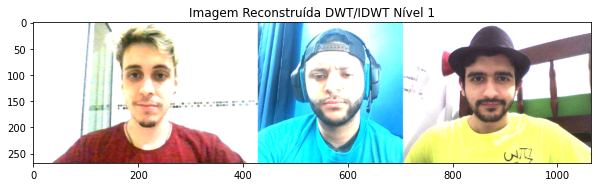




RODANDO A FUNÇÃO: reconstrucao_colorida_original



RODANDO A FUNÇÃO: calcular_mse_colorida


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


MSE_Red= 5.06e-13  MSE_Green= 5.47e-13  MSE_Blue= 6.32e-13



RODANDO A FUNÇÃO: calcular_snr_pico_colorida
PSNR total = 165.86 dB



RODANDO A FUNÇÃO: plotar_psnr


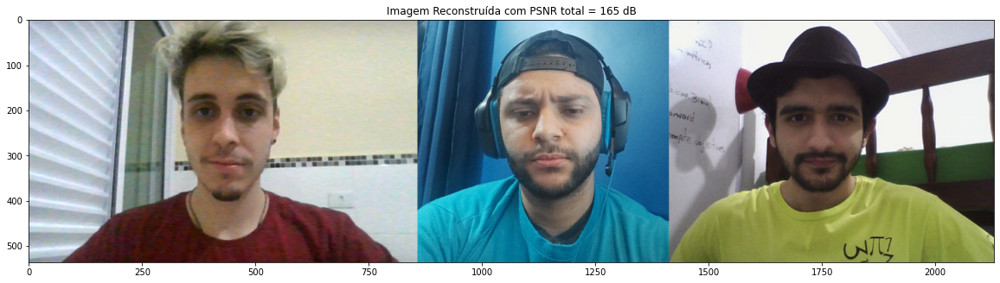

In [36]:
dirLab4 = dirGit.joinpath('lab4/imagens/')
data.append(main(dirLab4.joinpath('dimitri_william_matheus.png')))

### Exibindo as métricas de cada imagem em uma tabela

In [37]:
pd.DataFrame(data=data, columns=colunas)

,Arquivo,PSNR,MSE_R,MSE_G,MSE_B
0,matheus.png,167.782395,3.929635e-13,3.808541e-13,3.097123e-13
1,dimitri.png,164.309552,7.845354e-13,7.231642e-13,9.029004e-13
2,william.png,166.429145,1.827061e-13,5.424511e-13,7.545160e-13
3,dimitri_william_matheus.png,165.864992,5.062597e-13,5.471338e-13,6.315337e-13
